In [1]:
import sys
import os
import importlib
import gc
import glob
import random
from itertools import combinations

import numpy as np
import sklearn
from sklearn import metrics

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import ticker
import seaborn as sns

import pyemma
import msmtools
import mdtraj as md

import ivac
import extq

In [2]:
sys.path.insert(1, "../../python")
sys.path.insert(1, "../../..")
import util
import plotting

In [3]:
plt.style.use("custom")  # custom style sheet
plt.style.use("muted")  # muted color theme from SciencePlots
cm_seq = sns.cubehelix_palette(
    start=0, rot=-0.70, gamma=0.40, light=0.9, dark=0.1, as_cmap=True, reverse=True
)
cm_seq2 = sns.cubehelix_palette(
    start=0, rot=-0.70, gamma=0.40, light=0.8, dark=0.1, as_cmap=True, reverse=False
)
colors = mpl.colors.to_rgba_array(
    [
        "#364B9A",
        "#4A7BB7",
        "#6EA6CD",
        "#98CAE1",
        "#C2E4EF",
        "#EAECCC",
        "#FEDA8B",
        "#FDB366",
        "#F67E4B",
        "#DD3D2D",
        "#A50026",
    ]
)
cm_div = mpl.colors.LinearSegmentedColormap.from_list("", colors)

# Load data

In [4]:
cv_trajs = list(
    np.load("../../data/raw_feat/cv_dist_spin_anton.npy", allow_pickle=True)
)
cv_trajs.extend(
    np.load("../../data/raw_feat/cv_dist_spin_suppl_00.npy", allow_pickle=True)
)
cv_trajs.extend(
    np.load("../../data/raw_feat/cv_dist_spin_suppl_01.npy", allow_pickle=True)
)
cv_trajs.extend(
    np.load("../../data/raw_feat/cv_dist_spin_suppl_02.npy", allow_pickle=True)
)

In [5]:
sb_labels = []
for r in ("R217", "R223", "R226", "R229", "R232"):
    for n in ("D129", "D136", "D151", "D164", "E183", "D186"):
        sb_labels.append(f"{r} - {n}")

In [6]:
sb_trajs = list(np.load("../../data/raw_feat/feat2_raw_anton.npy", allow_pickle=True))
for i in range(6):
    sb_trajs.extend(
        np.load(f"../../data/raw_feat/feat2_suppl_{i:02d}.npy", allow_pickle=True)
    )

In [7]:
cv_arr = np.concatenate(cv_trajs)
sb_arr = np.concatenate(sb_trajs)
print(cv_arr.shape, sb_arr.shape)

(3729000, 2) (3729000, 60)


In [8]:
traj_files = np.loadtxt("../../data/suppl_traj_files.txt", dtype=str)

In [9]:
len(traj_files)

244

# Distance basis

In [10]:
dist = cv_arr[:, 0]
rot = cv_arr[:, 1]
# tic1 = livac_arr[:, 1]
# tic2 = livac_arr[:, 2]
sb1 = sb_arr[:, 42]  # R226-D129
sb2 = sb_arr[:, 47]  # R226-D186
sb3 = sb_arr[:, 48]  # R229-D129
sb4 = sb_arr[:, 53]  # R229-D186
sb5 = sb_arr[:, 59]  # R232-D186


# ellipse centered at down centroid with radii 1.1 nm and 8 deg (1 sigma in each direction)
# take points where R2-D186 < 0.5 (lower salt bridges), R2-D129 > 0.6 (upper salt bridge)
dist_ax_down = (dist + 4.240) / 1.1
rot_ax_down = (rot + 56.95) / 8
down_ids = (
    ((dist_ax_down ** 2 + rot_ax_down ** 2) < 1) & (sb1 > 0.6) & (sb2 < 0.5)
).nonzero()[0]

# ellipse centered at up centroid with radii 0.84 nm and 7.6 deg (2 sigma in each direction)
# take points where R2-D129 (up) < 0.5, R3-D129 < 1.1, R3/R4-D186 salt bridges < 0.75/0.6 nm
up_ids = (
    ((((dist + 0.506) / 0.84) ** 2 + ((rot - 3.94) / 7.6) ** 2) < 1)
    & (sb1 < 0.5)
    & (sb3 < 1.1)
    & (sb4 < 0.75)
    & (sb5 < 0.6)
).nonzero()[0]

In [11]:
mask = np.ones(len(cv_arr), dtype=bool)
mask[down_ids] = False
mask[up_ids] = False

# len(**_ids) is number of points in each state
down = sb_arr[down_ids]
up = sb_arr[up_ids]
other = sb_arr[mask]

# split CV data
down_cvs = cv_arr[down_ids]
up_cvs = cv_arr[up_ids]
other_cvs = cv_arr[mask]
down_sbs = sb_arr[down_ids]
up_sbs = sb_arr[up_ids]
other_sbs = cv_arr[mask]

In [12]:
assert (len(down_ids) + len(up_ids) + len(other_sbs)) == len(cv_arr)
print(f"Number of down structures:  {len(down_ids)}")
print(f"Number of up structures:   {len(up_ids)}")
print(f"Number of other structures: {len(other_sbs)}")

Number of down structures:  40649
Number of up structures:   6649
Number of other structures: 3681702


## Basis and smoothing

In [13]:
d_down_arr = np.load("../../data/feat2_dist_du_suppl_2/dist_down.npy")
d_up_arr = np.load("../../data/feat2_dist_du_suppl_2/dist_up.npy")

In [14]:
# make smoothing function
smooth = (d_down_arr * d_up_arr) ** 0.5 / (d_down_arr + d_up_arr)

# make guess
guess_down = (d_up_arr ** 2) / (d_down_arr ** 2 + d_up_arr ** 2)
guess_up = (d_down_arr ** 2) / (d_down_arr ** 2 + d_up_arr ** 2)

# make smoothing 0 at boundaries (down and up states)
smooth[(mask == 0).flatten()] = 0
# ensure homogeneous boundary conditions for guess
guess_up[up_ids] = 1
guess_up[down_ids] = 0
guess_down[down_ids] = 1
guess_down[up_ids] = 0

In [15]:
print(smooth.shape, guess_down.shape, guess_up.shape)

(3729000, 1) (3729000, 1) (3729000, 1)


In [16]:
import random

random.seed(123)

In [17]:
s = 10
N = len(cv_arr)
inds = random.sample(range(N), N // s)

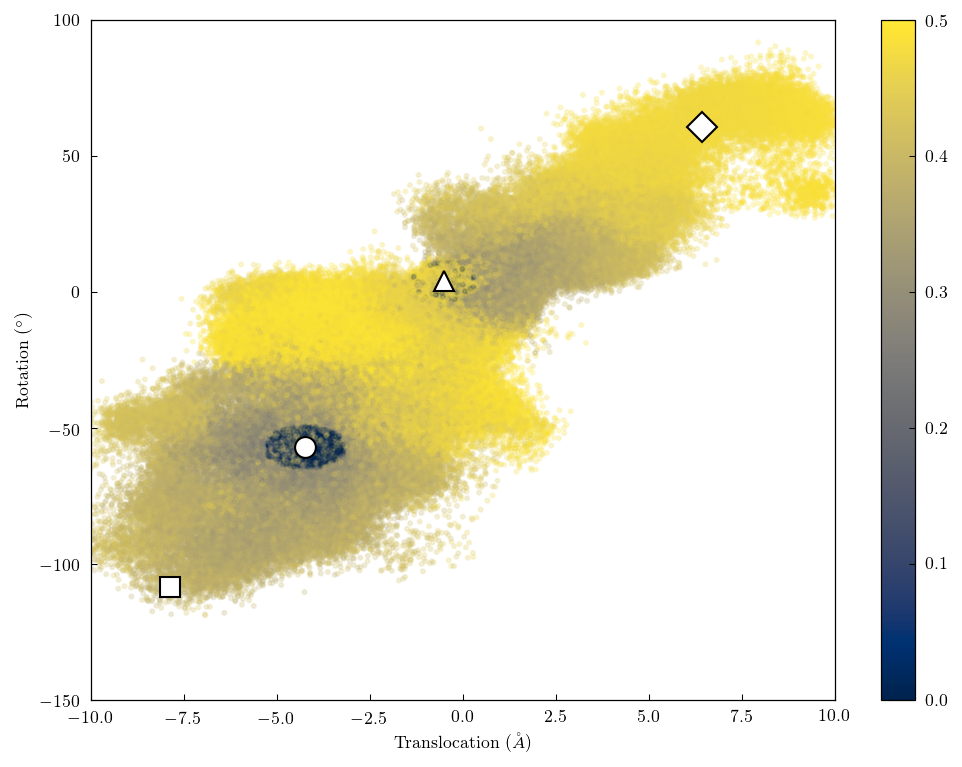

In [29]:
# Plot smoothing function
fig, ax = plt.subplots(figsize=(8, 6))
h = ax.scatter(
    cv_arr[inds, 0], cv_arr[inds, 1], c=smooth[inds], alpha=0.2, cmap="cividis"
)
cb = plt.colorbar(h, ax=ax)
cb.solids.set(alpha=1.0)
plotting.format_cvs(ax)

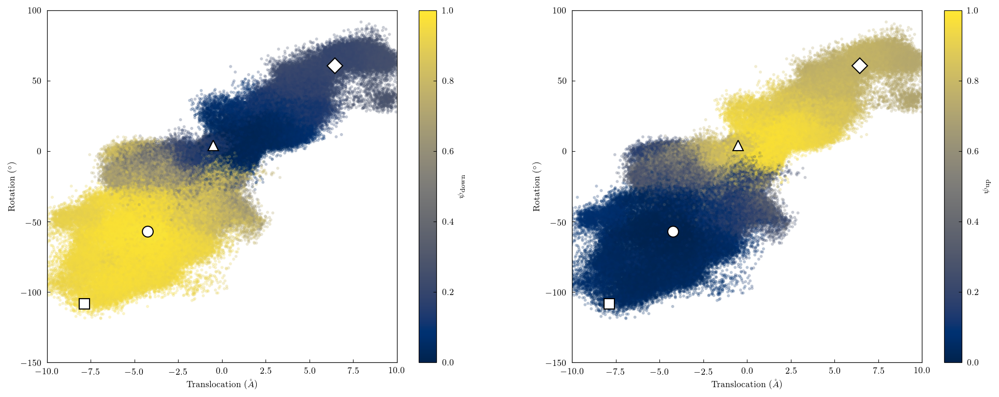

In [30]:
# Plot down and up state guess function
fig, axs = plt.subplots(1, 2, figsize=(16, 6))
labels = ("$\psi_{\mathrm{down}}$", "$\psi_{\mathrm{up}}$")
for ax, g, label in zip(axs, (guess_down, guess_up), labels):
    h = ax.scatter(
        cv_arr[inds, 0], cv_arr[inds, 1], c=g[inds], alpha=0.2, cmap="cividis"
    )
    cb = plt.colorbar(h, ax=ax, label=label)
    cb.solids.set(alpha=1.0)
    plotting.format_cvs(ax)

# Basis

In [31]:
def orthogonalize(basis, pi):
    numer = 0
    for b, p in zip(basis, pi):
        numer += np.einsum("m,mi,mj->ij", p, b, b)
        denom += np.sum(p)
    evals, evecs = scipy.linalg.eigh(numer / denom)
    coeffs = evecs / np.sqrt(evals)[None, :]
    return [b @ coeffs for b in basis]

In [32]:
basis_smooth = smooth * sb_arr
print(basis_smooth.shape)
basis_white, L = util.svd_whiten(basis_smooth, 1, frac_retain=1.0)
basis_white[(mask == 0).flatten()] = 0
print(basis_white.shape)

(3729000, 60)
(3729000, 59)


Text(0.5, 1.0, 'Smoothed and orthorgonalized basis')

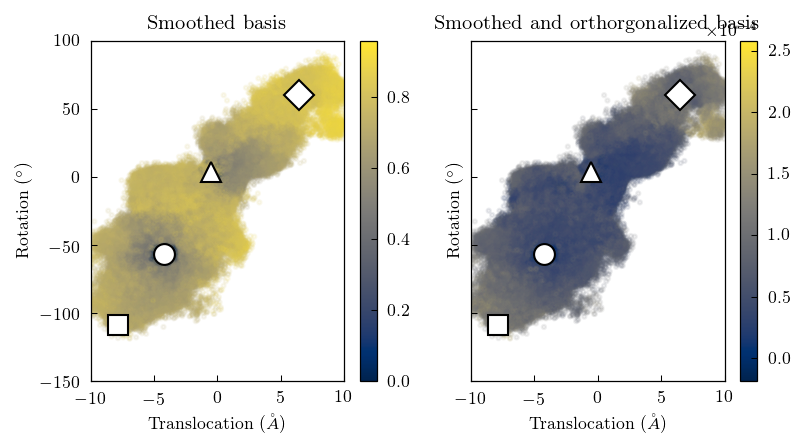

In [35]:
# plot bases
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 3), sharex=True, sharey=True)
h1 = ax1.scatter(
    cv_arr[inds, 0],
    cv_arr[inds, 1],
    c=np.mean(basis_smooth[inds, :], axis=1),
    alpha=0.1,
    cmap="cividis",
)
h2 = ax2.scatter(
    cv_arr[inds, 0],
    cv_arr[inds, 1],
    c=np.mean(basis_white[inds, :], axis=1),
    alpha=0.1,
    cmap="cividis",
)
for h, ax in zip((h1, h2), (ax1, ax2)):
    plotting.format_cvs(ax)
    cb = plt.colorbar(h, ax=ax)
    cb.solids.set(alpha=1)
ax1.set_title("Smoothed basis")
ax2.set_title("Smoothed and orthorgonalized basis")

In [18]:
# split into lists of arrays
traj_inds = util.split_indices(cv_trajs)

traj_lens = [len(traj) for traj in cv_trajs]
guessU = np.split(np.squeeze(guess_up), traj_inds)
guessD = np.split(np.squeeze(guess_down), traj_inds)

print(len(guessU))
print(len(guessD))
basisF = np.split(basis_white, traj_inds)
print(len(basisF), basisF[0].shape)

480
480


NameError: name 'basis_white' is not defined

In [19]:
lags = [1, 2, 5, 10, 20, 50, 100]

In [20]:
weights = np.load("../../data/feat2_dist_du_suppl_2/weights.npy", allow_pickle=True)[:7]

In [21]:
len(weights)

7

# Committors

In [22]:
in_domain = np.split(mask, traj_inds)
in_domain[0].shape

(10000,)

In [23]:
len(in_domain)

480

In [48]:
qp_du, qm_du, qp_ud, qm_ud = [], [], [], []
for (lag, com) in zip(lags, weights):
    print(f"Calculating committors for lag {lag}")
    qp_du.append(extq.dga.forward_committor(basisF, com, in_domain, guessU, lag))
    qm_du.append(extq.dga.backward_committor(basisF, com, in_domain, guessD, lag))
    qp_ud.append(extq.dga.forward_committor(basisF, com, in_domain, guessD, lag))
    qm_ud.append(extq.dga.backward_committor(basisF, com, in_domain, guessU, lag))

Calculating committors for lag 1
Calculating committors for lag 2
Calculating committors for lag 5
Calculating committors for lag 10
Calculating committors for lag 20
Calculating committors for lag 50
Calculating committors for lag 100


AssertionError: 

In [49]:
np.save("../../data/feat2_dist_du_suppl_2/q_downup", qp_du)
np.save("../../data/feat2_dist_du_suppl_2/qb_downup", qm_du)
np.save("../../data/feat2_dist_du_suppl_2/q_updown", qp_ud)
np.save("../../data/feat2_dist_du_suppl_2/qb_updown", qp_ud)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [24]:
qp_du = np.load("../../data/feat2_dist_du_suppl_2/q_downup.npy", allow_pickle=True)
qm_du = np.load("../../data/feat2_dist_du_suppl_2/qb_downup.npy", allow_pickle=True)
qp_ud = np.load("../../data/feat2_dist_du_suppl_2/q_updown.npy", allow_pickle=True)
qp_ud = np.load("../../data/feat2_dist_du_suppl_2/qb_updown.npy", allow_pickle=True)

## Plot committors

findfont: Font family ['"Computer Modern Sans Serif"'] not found. Falling back to DejaVu Sans.


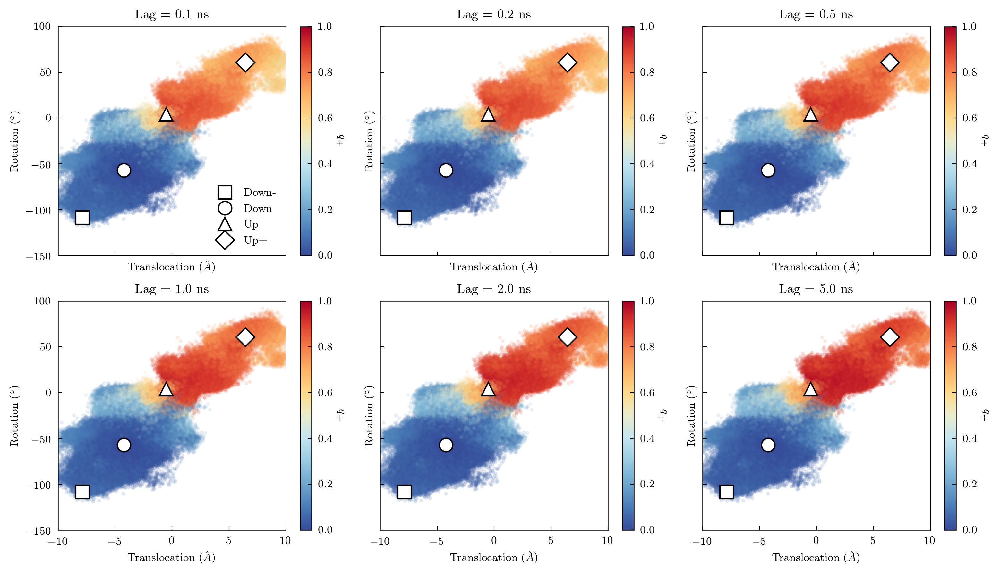

In [51]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)
for lag, q, ax in zip(lags, qp_du, axs.flat):
    q_arr = np.concatenate(q).clip(min=0.0, max=1.0)
    h = ax.scatter(*cv_arr[inds].T, c=q_arr[inds], cmap=cm_div, alpha=0.1)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    plotting.format_cvs(ax, centroids=True)
    cbar.set_label("$q_+$", rotation=-90, labelpad=10)

axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="lower right")
f.tight_layout()
# plt.savefig("../../fig/committors/q_feat2_dist_du_suppl_ds_alllags", dpi=300)

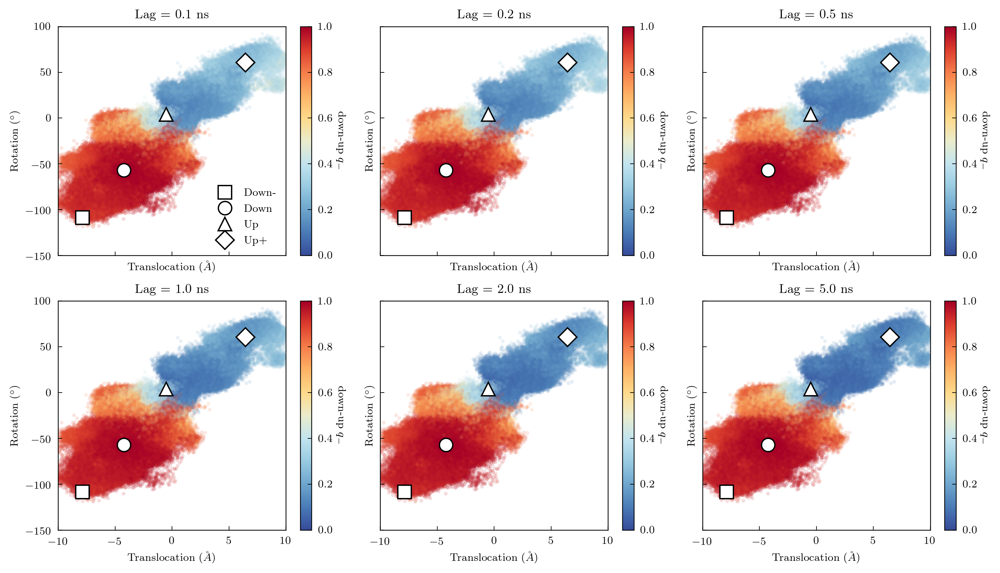

In [52]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)
for lag, q, ax in zip(lags, qm_du, axs.flat):
    q_arr = np.concatenate(q).clip(min=0.0, max=1.0)
    h = ax.scatter(*cv_arr[inds].T, c=q_arr[inds], cmap=cm_div, alpha=0.1)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    plotting.format_cvs(ax, centroids=True)
    cbar.set_label("down-up $q_-$", rotation=-90, labelpad=10)

axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="lower right")
f.tight_layout()

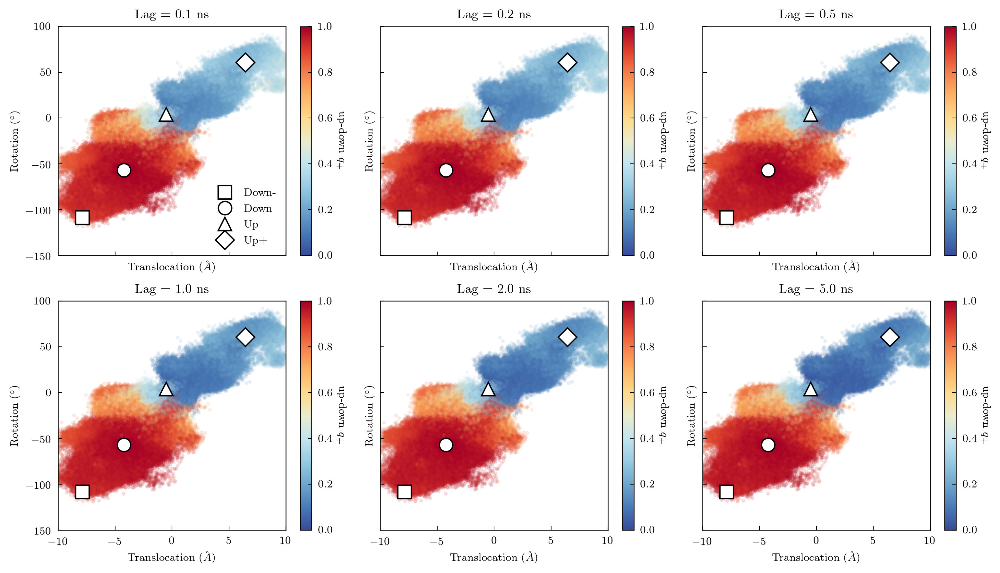

In [53]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)
for lag, q, ax in zip(lags, qp_ud, axs.flat):
    q_arr = np.concatenate(q).clip(min=0.0, max=1.0)
    h = ax.scatter(*cv_arr[inds].T, c=q_arr[inds], cmap=cm_div, alpha=0.1)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    plotting.format_cvs(ax, centroids=True)
    cbar.set_label("up-down $q_+$", rotation=-90, labelpad=10)

axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="lower right")
f.tight_layout()

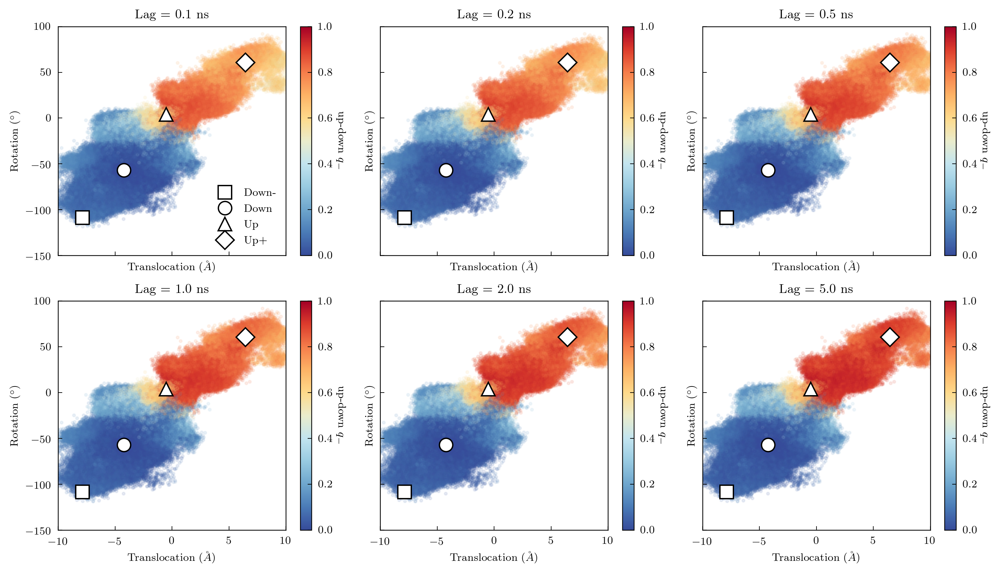

In [54]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)
for lag, q, ax in zip(lags, qm_ud, axs.flat):
    q_arr = np.concatenate(q).clip(min=0.0, max=1.0)
    h = ax.scatter(*cv_arr[inds].T, c=q_arr[inds], cmap=cm_div, alpha=0.1)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    plotting.format_cvs(ax, centroids=True)
    cbar.set_label("up-down $q_-$", rotation=-90, labelpad=10)

axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="lower right")
f.tight_layout()

## TS

In [69]:
# extract points which are between 0.45 and 0.55 committor
q = np.concatenate(qp_du[5])
q_ts_inds = ((q < 0.5) & (q > 0.45)).nonzero()[0]
q_ts = q[q_ts_inds]

In [70]:
sb_ts = sb_arr[q_ts_inds]

In [71]:
len(q_ts)

66064

In [55]:
sb_ids = [42, 48, 47, 53]

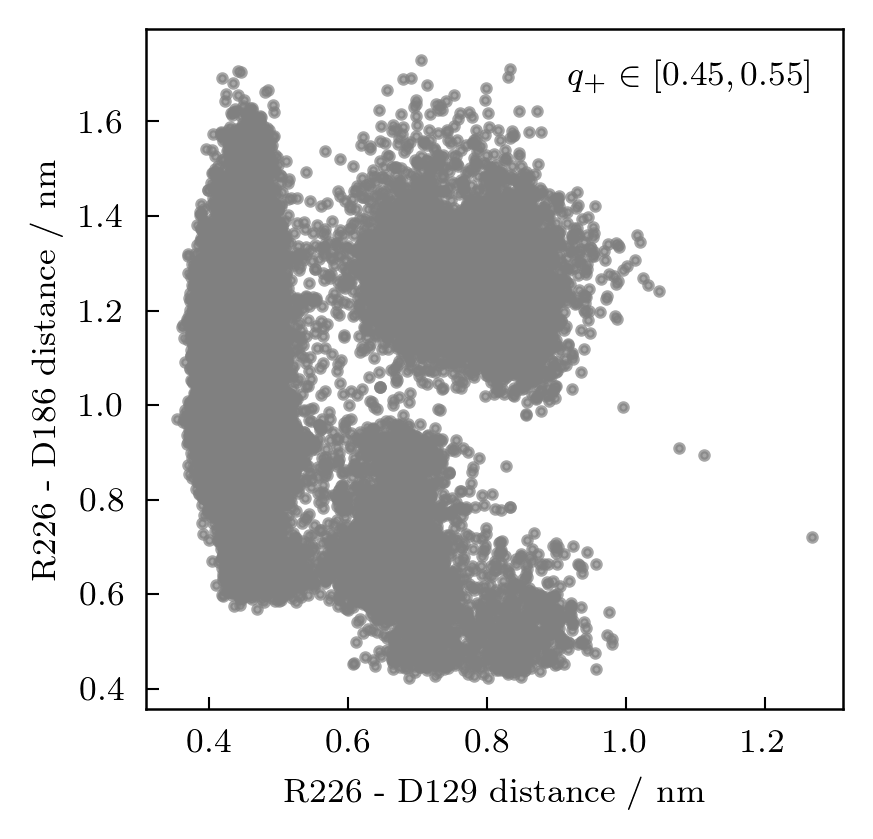

In [72]:
f = plt.figure(dpi=300)
ax = plt.gca()
h = ax.scatter(sb_ts[..., sb_ids[0]], sb_ts[..., sb_ids[2]], alpha=0.7, color="grey")
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]} distance / nm")
ax.set_ylabel(f"{sb_labels[sb_ids[2] - 30]} distance / nm")
ax.legend(["$q_+ \in [0.45, 0.55]$ "])

Text(0, 0.5, 'R226 - D186')

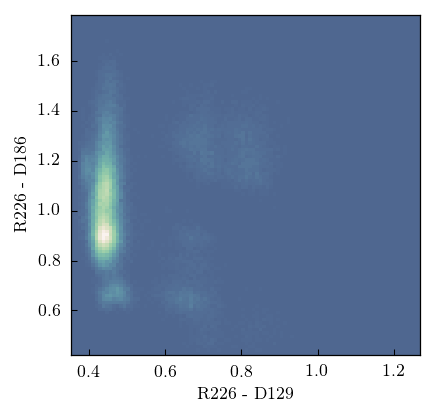

In [61]:
f = plt.figure()
ax = plt.gca()
h = ax.hist2d(
    sb_ts[..., sb_ids[0]], sb_ts[..., sb_ids[2]], bins=100, density=True, cmap=cm_seq
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[2] - 30])

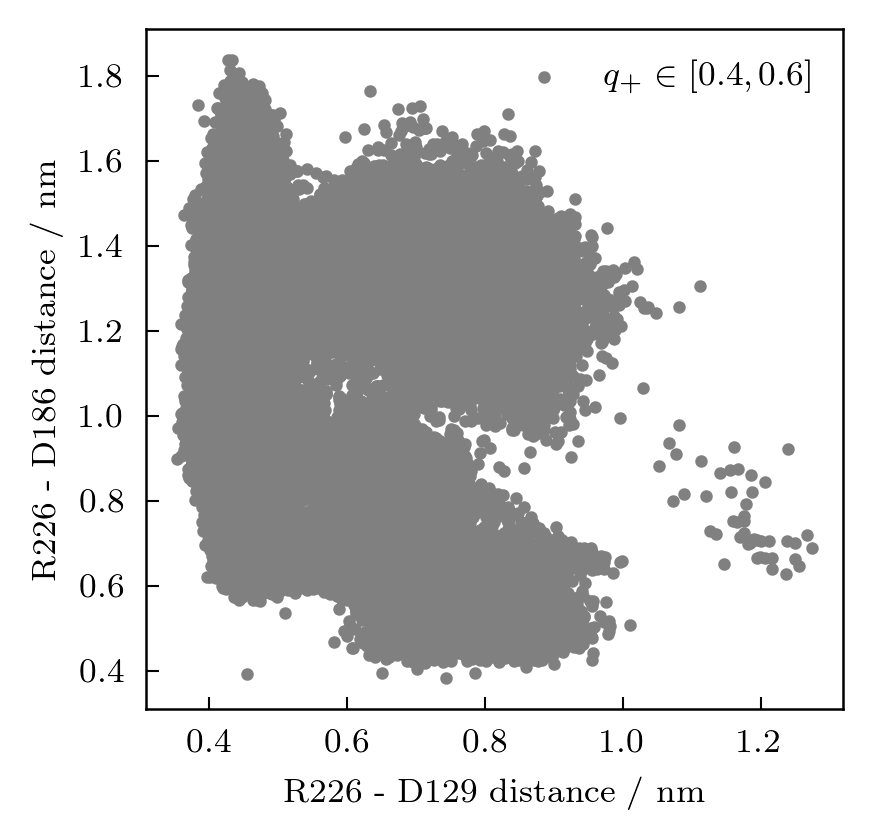

In [67]:
q_ts_inds = ((q < 0.6) & (q > 0.4)).nonzero()[0]
sb_ts = sb_arr[q_ts_inds]

f = plt.figure(dpi=300)
ax = plt.gca()
h = ax.scatter(sb_ts[..., sb_ids[0]], sb_ts[..., sb_ids[2]], color="grey")
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]} distance / nm")
ax.set_ylabel(f"{sb_labels[sb_ids[2] - 30]} distance / nm")
ax.legend(["$q_+ \in [0.4, 0.6]$ "])

# Currents

In [73]:
j_du_sb, j_ud_sb = [], []

for (lag, com, qp, qm) in zip(lags, weights, qp_du, qm_du):
    print(f"Computing currents for down->up, lag = {lag}")
    j_sb = []
    for i in sb_ids:
        sb = [t[:, i] for t in sb_trajs]
        j_sb.append(extq.tpt.current(qp, qm, com, in_domain, sb, lag))
    j_du_sb.append(np.stack(j_sb, axis=-1))

for (lag, com, qp, qm) in zip(lags, weights, qp_ud, qm_ud):
    print(f"Computing currents for up->down, lag = {lag}")
    j_sb = []
    for i in sb_ids:
        sb = [t[:, i] for t in sb_trajs]
        j_sb.append(extq.tpt.current(qp, qm, com, in_domain, sb, lag))
    j_ud_sb.append(np.stack(j_sb, axis=-1))

Computing currents for down->up, lag = 1


/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/shape_base.py:420: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arrays = [asanyarray(arr) for arr in arrays]


Computing currents for down->up, lag = 2
Computing currents for down->up, lag = 5
Computing currents for down->up, lag = 10
Computing currents for down->up, lag = 20
Computing currents for down->up, lag = 50
Computing currents for up->down, lag = 1
Computing currents for up->down, lag = 2
Computing currents for up->down, lag = 5
Computing currents for up->down, lag = 10
Computing currents for up->down, lag = 20
Computing currents for up->down, lag = 50


In [31]:
j_du_ds, j_ud_ds = [], []
d_trajs = [t[:, 0] for t in cv_trajs]
s_trajs = [t[:, 1] for t in cv_trajs]

In [78]:
for (lag, com, qp, qm) in zip(lags, weights, qp_du, qm_du):
    print(f"Computing currents for down->up, lag = {lag}")
    j_d = extq.tpt.current(qp, qm, com, in_domain, d_trajs, lag)
    j_s = extq.tpt.current(qp, qm, com, in_domain, s_trajs, lag)
    j_du_ds.append(np.stack((j_d, j_s), axis=-1))

for (lag, com, qp, qm) in zip(lags, weights, qp_ud, qm_ud):
    print(f"Computing currents for up->down, lag = {lag}")
    j_d = extq.tpt.current(qp, qm, com, in_domain, d_trajs, lag)
    j_s = extq.tpt.current(qp, qm, com, in_domain, s_trajs, lag)
    j_ud_ds.append(np.stack((j_d, j_s), axis=-1))

Computing currents for down->up, lag = 1


/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/shape_base.py:420: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arrays = [asanyarray(arr) for arr in arrays]


Computing currents for down->up, lag = 2
Computing currents for down->up, lag = 5
Computing currents for down->up, lag = 10
Computing currents for down->up, lag = 20
Computing currents for down->up, lag = 50
Computing currents for up->down, lag = 1
Computing currents for up->down, lag = 2
Computing currents for up->down, lag = 5
Computing currents for up->down, lag = 10
Computing currents for up->down, lag = 20
Computing currents for up->down, lag = 50


In [79]:
np.save("../../data/feat2_dist_du_suppl_2/j_du_sb", j_du_sb)
np.save("../../data/feat2_dist_du_suppl_2/j_ud_sb", j_ud_sb)
np.save("../../data/feat2_dist_du_suppl_2/j_du_ds", j_du_ds)
np.save("../../data/feat2_dist_du_suppl_2/j_ud_ds", j_ud_ds)

In [41]:
j_du_sb = np.load("../../data/feat2_dist_du_suppl_2/j_du_sb.npy", allow_pickle=True)
j_ud_sb = np.load("../../data/feat2_dist_du_suppl_2/j_ud_sb.npy", allow_pickle=True)
j_du_ds = np.load("../../data/feat2_dist_du_suppl_2/j_du_ds.npy", allow_pickle=True)
j_ud_ds = np.load("../../data/feat2_dist_du_suppl_2/j_ud_ds.npy", allow_pickle=True)

## Translocation/rotation CVs

In [42]:
len(j_du_ds[0][:, 0])

480

In [43]:
np.concatenate(j_du_ds[0][:, 0]).shape

(3729000,)

In [44]:
# binning the Jx and Jy fluxes on the distance/spin space
n = 19
xmin, xmax, ymin, ymax = -10, 10, -150, 100

In [45]:
ylim_flux = np.linspace(ymin, ymax, n + 1)

centerx_flux = (xlim_flux[1:] + xlim_flux[:-1]) / 2
centery_flux = (ylim_flux[1:] + ylim_flux[:-1]) / 2

X, Y = np.meshgrid(centerx_flux, centery_flux)

clines = np.linspace(0, 12, 13)
n_pmf = 50
xlim = np.linspace(xmin, xmax, n_pmf)
ylim = np.linspace(ymin, ymax, n_pmf)
centerx = (xlim[1:] + xlim[:-1]) / 2
centery = (ylim[1:] + ylim[:-1]) / 2

pmf = extq.projection.density2d(d_trajs, s_trajs, weights[0], xlim, ylim)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log


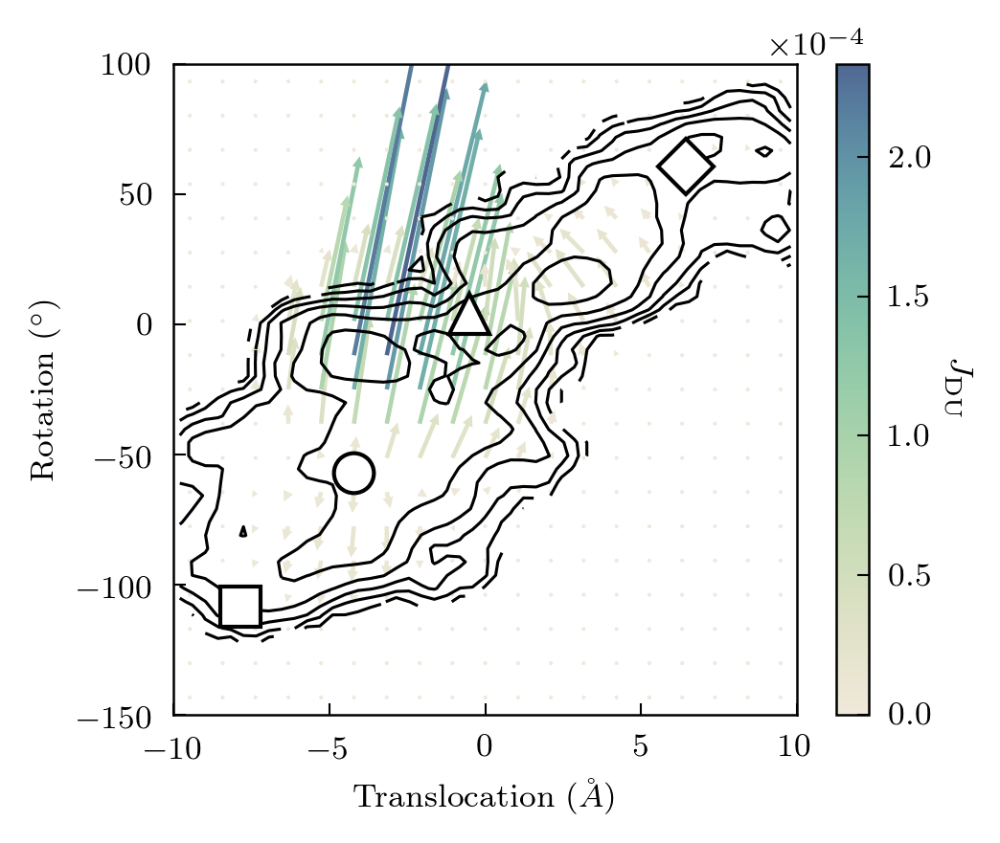

In [112]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = plt.gca()

jx_binned, xe, ye = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[0][:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[0][:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# normalize arrow so same
h = ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cm_seq2,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)
cb = plt.colorbar(h, ax=ax)
cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

plotting.format_cvs(ax)

# plot PMF
min_energy = np.min(-np.log(pmf[np.nonzero(pmf)]))
diff = -np.log(pmf.T) - min_energy
ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="black")

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: divide by zero encountered in log


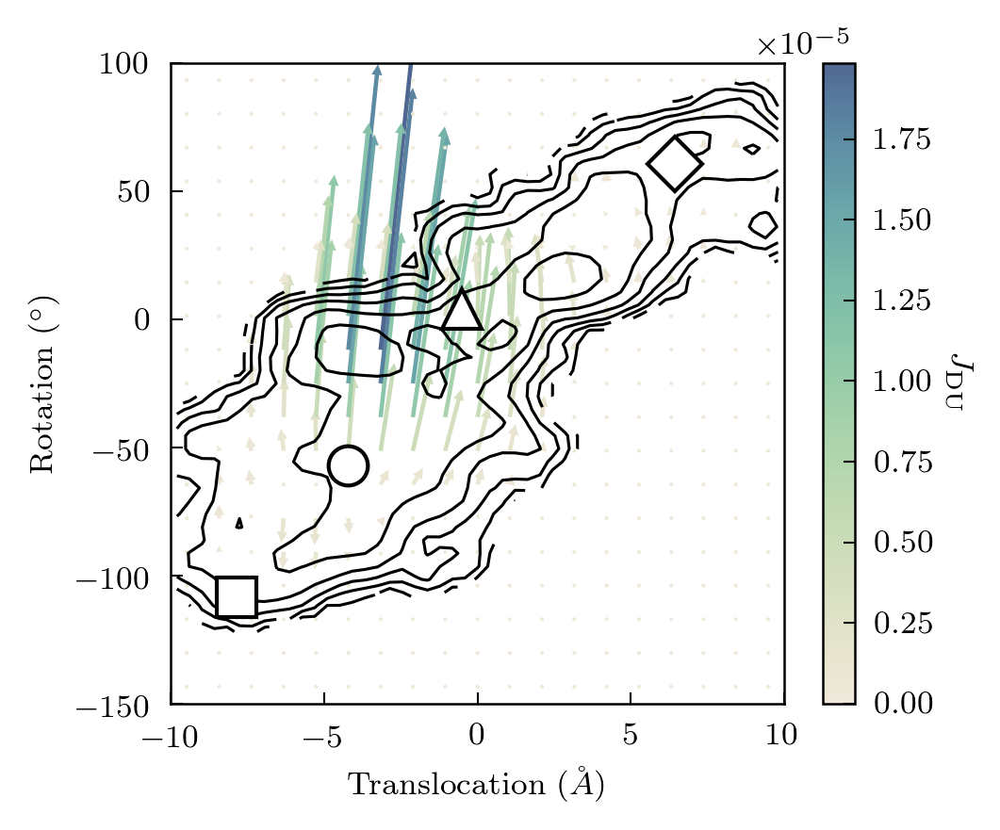

In [117]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = plt.gca()

jx_binned, xe, ye = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# normalize arrow so same
h = ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cm_seq2,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)
cb = plt.colorbar(h, ax=ax)
cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

plotting.format_cvs(ax)

# plot PMF
min_energy = np.min(-np.log(pmf[np.nonzero(pmf)]))
diff = -np.log(pmf.T) - min_energy
ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="black")

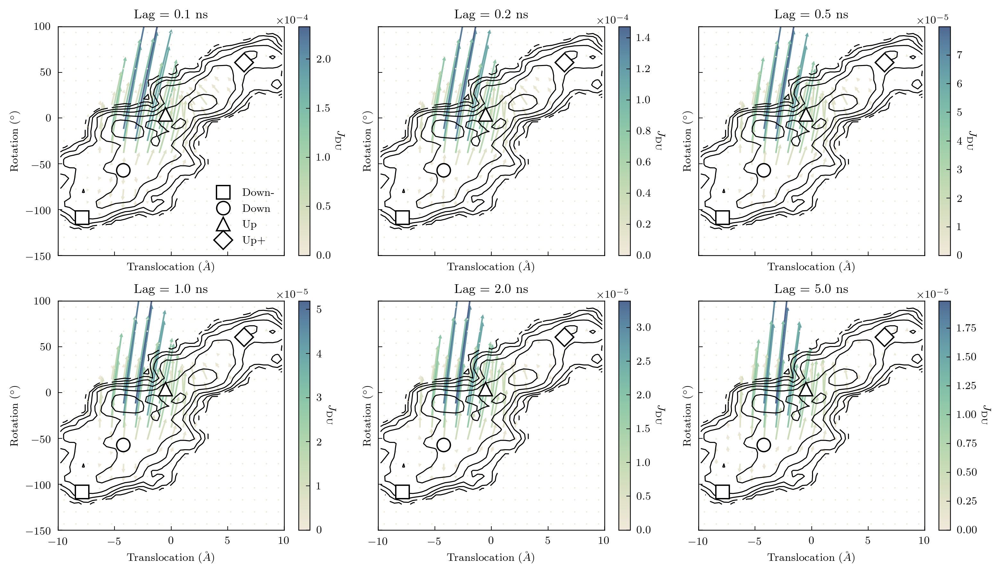

In [114]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)

for lag, j, ax in zip(lags, j_du_ds, axs.flat):
    # KDE bin fluxes
    jx_binned, _, _ = util.kdesum2d(
        cv_arr[:, 0],
        cv_arr[:, 1],
        np.concatenate(j[:, 0]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )
    jy_binned, _, _ = util.kdesum2d(
        cv_arr[:, 0],
        cv_arr[:, 1],
        np.concatenate(j[:, 1]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )

    # set color/magnitude of arrow equal to L2 norm od KDEd fluxes
    col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

    # normalize arrow so same
    h = ax.quiver(
        X,
        Y,
        jx_binned.T,
        jy_binned.T,
        col.T,
        width=0.007,
        cmap=cm_seq2,
        headwidth=2.5,
        headlength=2.5,
        headaxislength=2.5,
    )
    cb = plt.colorbar(h, ax=ax)
    cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

    plotting.format_cvs(ax)

    # plot PMF
    ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="black")
    ax.set_title(f"Lag = {lag * 0.1} ns")

axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="lower right")
f.tight_layout()

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: divide by zero encountered in log


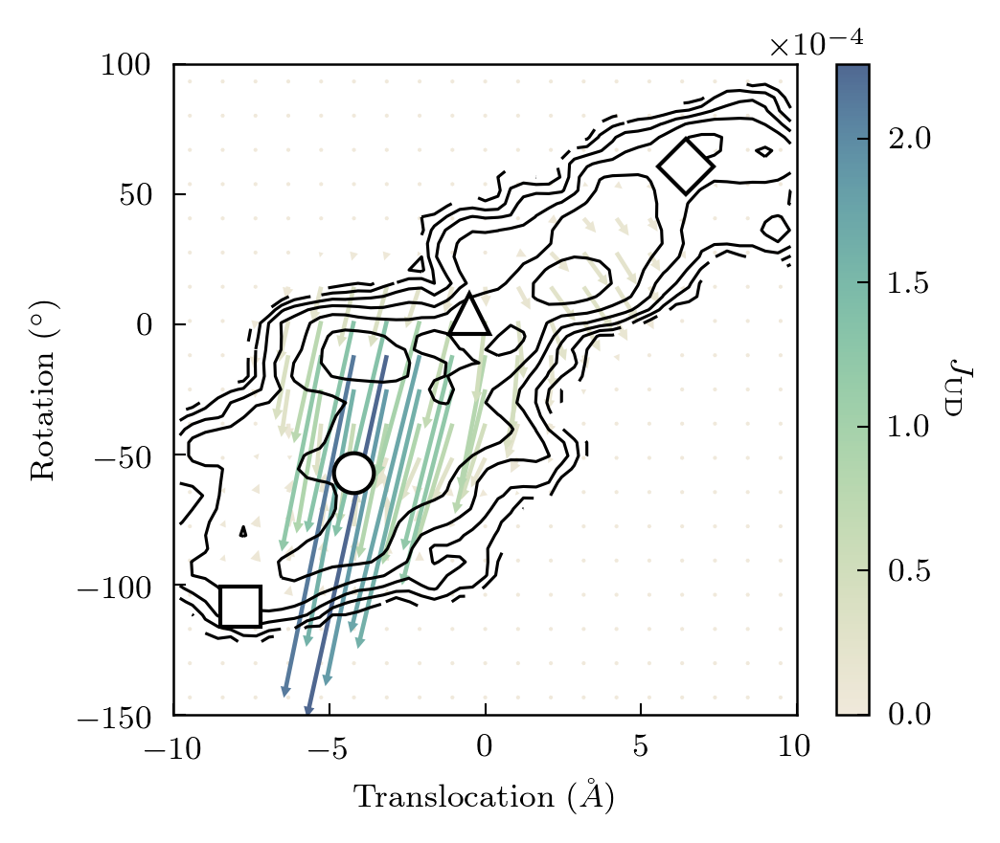

In [115]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = plt.gca()

jx_binned, xe, ye = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_ud_ds[0][:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_ud_ds[0][:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# normalize arrow so same
h = ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cm_seq2,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)
cb = plt.colorbar(h, ax=ax)
cb.set_label("$J_{\mathrm{UD}}$", rotation=-90, labelpad=10)

plotting.format_cvs(ax)

# plot PMF
min_energy = np.min(-np.log(pmf[np.nonzero(pmf)]))
diff = -np.log(pmf.T) - min_energy
ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="black")

In [136]:
# compute reactive density for dissociation
# bin committors
w = np.concatenate(weights[5])
q_arr = np.concatenate(qp_du[5]).clip(min=0, max=1)
qb_arr = np.concatenate(qm_du[5]).clip(min=0, max=1)
q_dens, xe, ye = np.histogram2d(
    cv_arr[:, 0], cv_arr[:, 1], bins=n_pmf - 1, density=False, weights=q_arr * w
)
qb_dens, _, _ = np.histogram2d(
    cv_arr[:, 0], cv_arr[:, 1], bins=n_pmf - 1, density=False, weights=qb_arr * w
)
w_dens, _, _ = np.histogram2d(
    cv_arr[:, 0], cv_arr[:, 1], bins=n_pmf - 1, density=False, weights=w
)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


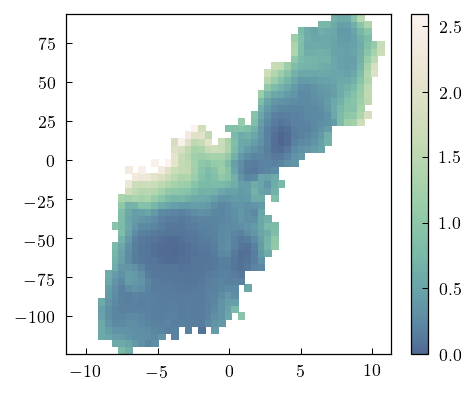

In [137]:
_ = plt.figure(figsize=(3.5, 3))
pi_reactive = diff * (q_dens / w_dens) * (qb_dens / w_dens)
plt.pcolor(xe, ye, pi_reactive.T, cmap=cm_seq)
plt.colorbar()

In [49]:
# color arrows from transparent to white depending on magnitude
rgb = 1 / 256
colors = [(rgb, rgb, rgb, c) for c in np.linspace(0.1, 1, 100)]
cmapwhite = mpl.colors.LinearSegmentedColormap.from_list("mycmap", colors)

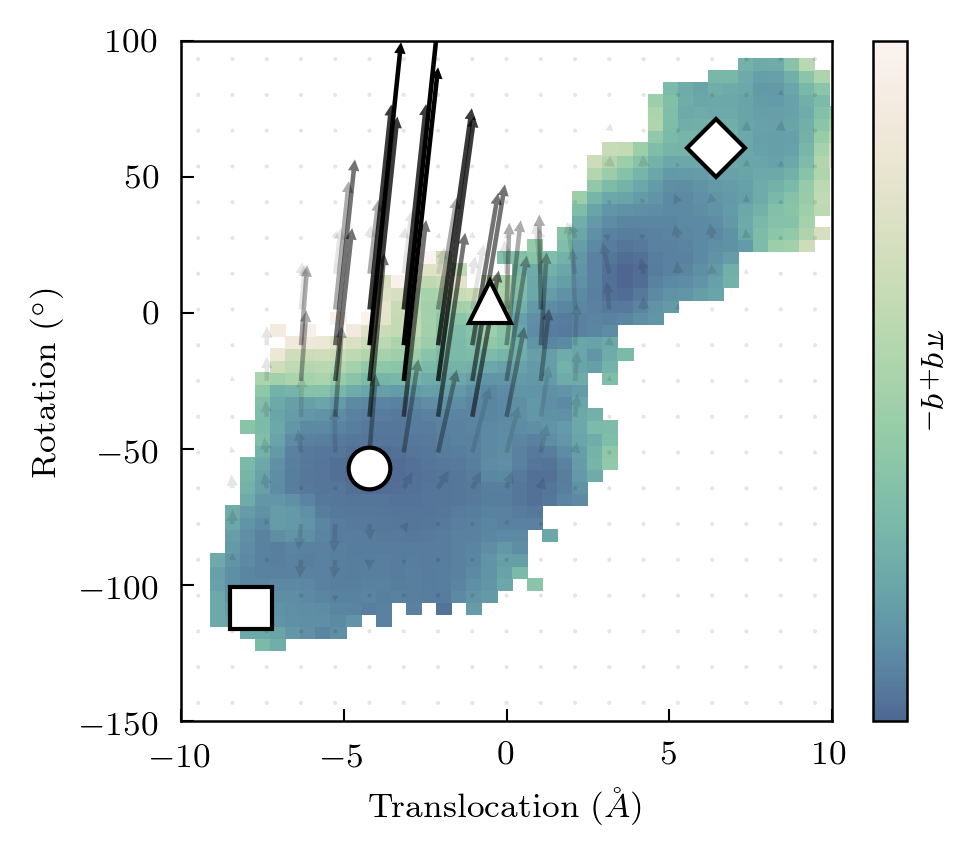

In [148]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = plt.gca()

jx_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot reactive density
h = ax.pcolor(xe, ye, pi_reactive.T, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("$\pi q_+ q_-$", rotation=-90, labelpad=10)
cb.set_ticks([])

# normalize arrow so same
ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

plotting.format_cvs(ax)

/tmp/jobs/16494128/ipykernel_247788/475313004.py:17: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(pmf.T) - min_energy


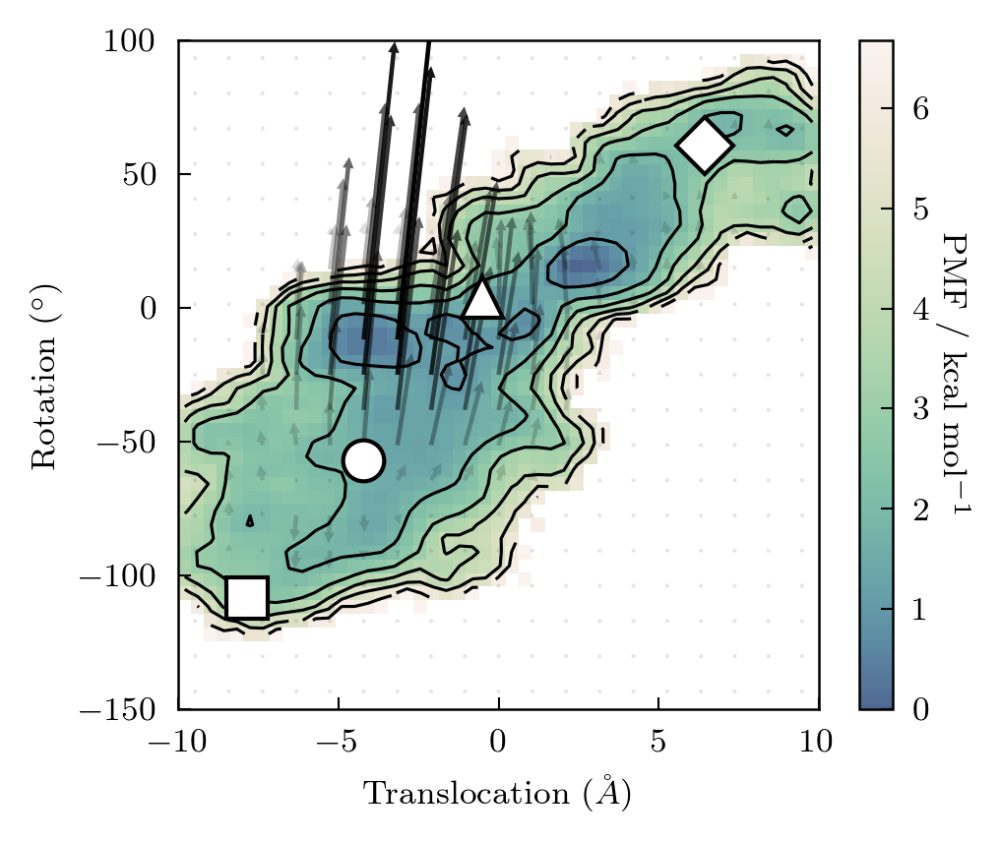

In [50]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = plt.gca()

jx_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot reactive density
# plot PMF
min_energy = np.min(-np.log(pmf[np.nonzero(pmf)]))
diff = -np.log(pmf.T) - min_energy
h = ax.pcolor(centerx, centery, diff * 0.593, cmap=cm_seq)
ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="black")
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

# normalize arrow so same
ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

plotting.format_cvs(ax)

/tmp/jobs/16494128/ipykernel_247788/1856747501.py:17: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(pmf.T) - min_energy


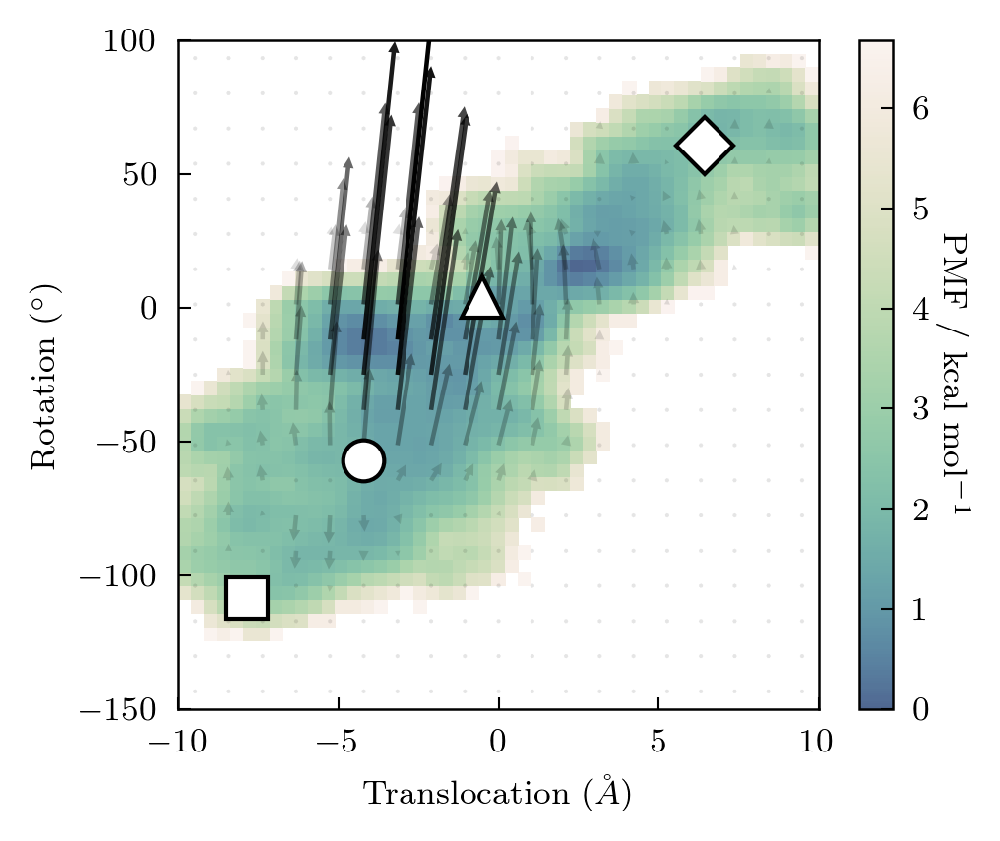

In [51]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = plt.gca()

jx_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    cv_arr[:, 0],
    cv_arr[:, 1],
    np.concatenate(j_du_ds[-1][:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot reactive density
# plot PMF
min_energy = np.min(-np.log(pmf[np.nonzero(pmf)]))
diff = -np.log(pmf.T) - min_energy
h = ax.pcolor(centerx, centery, diff * 0.593, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

# normalize arrow so same
ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

plotting.format_cvs(ax)

## Salt bridge distances

In [52]:
# binning the Jx and Jy fluxes on the distance/spin space
n = 19
xmin, xmax, ymin, ymax = 0.3, 2.0, 0.3, 2.0

In [53]:
xlim_flux = np.linspace(xmin, xmax, n + 1)
ylim_flux = np.linspace(ymin, ymax, n + 1)

centerx_flux = (xlim_flux[1:] + xlim_flux[:-1]) / 2
centery_flux = (ylim_flux[1:] + ylim_flux[:-1]) / 2

X, Y = np.meshgrid(centerx_flux, centery_flux)

clines = np.linspace(0, 12, 13)
n_pmf = 50
xlim = np.linspace(xmin, xmax, n_pmf)
ylim = np.linspace(ymin, ymax, n_pmf)
centerx = (xlim[1:] + xlim[:-1]) / 2
centery = (ylim[1:] + ylim[:-1]) / 2

In [56]:
pmf_sb = []
for (sb1, sb2) in combinations(sb_ids, 2):
    sb1_trajs = [t[:, sb1] for t in sb_trajs]
    sb2_trajs = [t[:, sb2] for t in sb_trajs]
    pmf_sb.append(
        extq.projection.density2d(sb1_trajs, sb2_trajs, weights[0], xlim, ylim)
    )

/tmp/jobs/16494128/ipykernel_247788/339395080.py:31: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(p.T) - min_energy


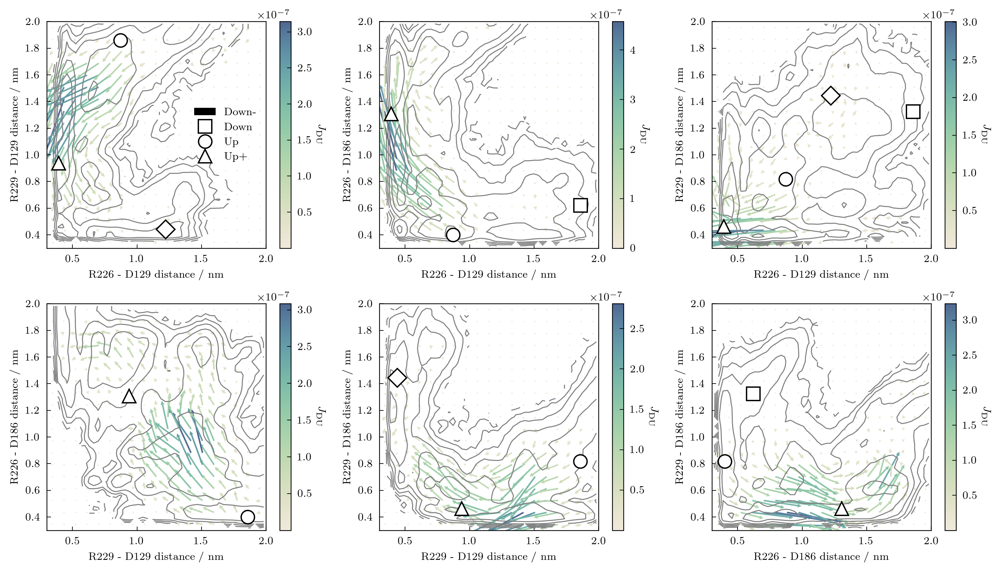

In [ ]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), dpi=300)

flux = j_du_sb[-1]
for ((i, j), ax, p) in zip(combinations(range(4), 2), axs.flat, pmf_sb):
    sb1, sb2 = sb_ids[i], sb_ids[j]

    # KDE bin fluxes
    jx_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, i]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )
    jy_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, j]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )

    # set color/magnitude of arrow equal to L2 norm od KDEd fluxes
    col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

    # normalize arrow so same
    h = ax.quiver(
        X,
        Y,
        jx_binned.T,
        jy_binned.T,
        col.T,
        width=0.007,
        cmap=cm_seq2,
        headwidth=2.5,
        headlength=2.5,
        headaxislength=2.5,
    )
    cb = plt.colorbar(h, ax=ax)
    cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

    # plot PMF
    min_energy = np.min(-np.log(p[np.nonzero(p)]))
    diff = -np.log(p.T) - min_energy
    ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="grey")

    ax.set(
        xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
        ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
        xlim=[0.3, 2.0],
        ylim=[0.3, 2.0],
    )

plotting.plot_sb_models(axs.flat, mode="du", centroids=True)
axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.tight_layout()

lag = 0.1 ns

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in log


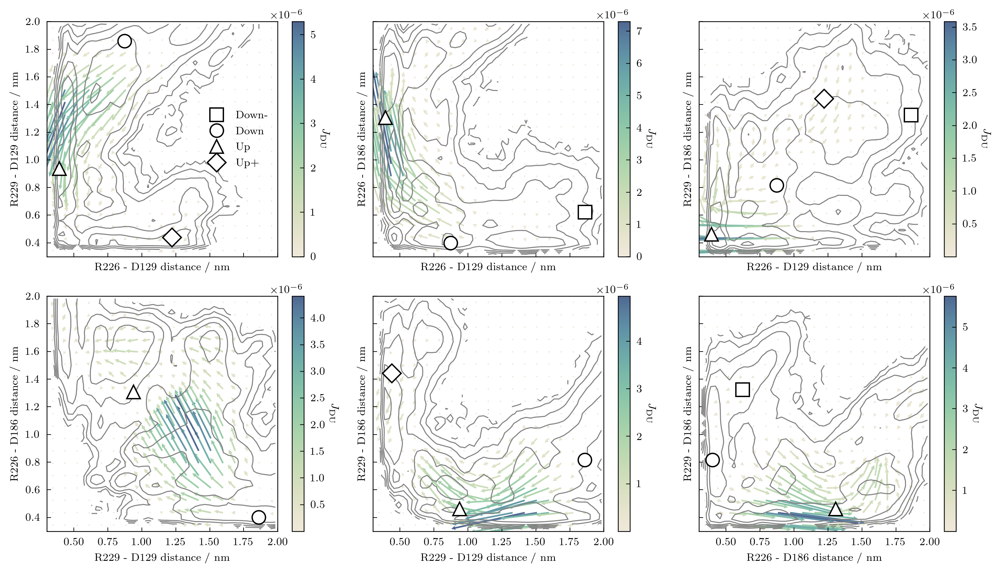

In [160]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)

flux = j_du_sb[0]
for ((i, j), ax, p) in zip(combinations(range(4), 2), axs.flat, pmf_sb):
    sb1, sb2 = sb_ids[i], sb_ids[j]

    # KDE bin fluxes
    jx_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, i]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )
    jy_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, j]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )

    # set color/magnitude of arrow equal to L2 norm od KDEd fluxes
    col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

    # normalize arrow so same
    h = ax.quiver(
        X,
        Y,
        jx_binned.T,
        jy_binned.T,
        col.T,
        width=0.007,
        cmap=cm_seq2,
        headwidth=2.5,
        headlength=2.5,
        headaxislength=2.5,
    )
    cb = plt.colorbar(h, ax=ax)
    cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

    # plot PMF
    min_energy = np.min(-np.log(p[np.nonzero(p)]))
    diff = -np.log(p.T) - min_energy
    ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="grey")

    ax.set(
        xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
        ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
        xlim=[0.3, 2.0],
        ylim=[0.3, 2.0],
    )

plotting.plot_sb_models(axs.flat, mode="du", centroids=True)
axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.tight_layout()

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in log


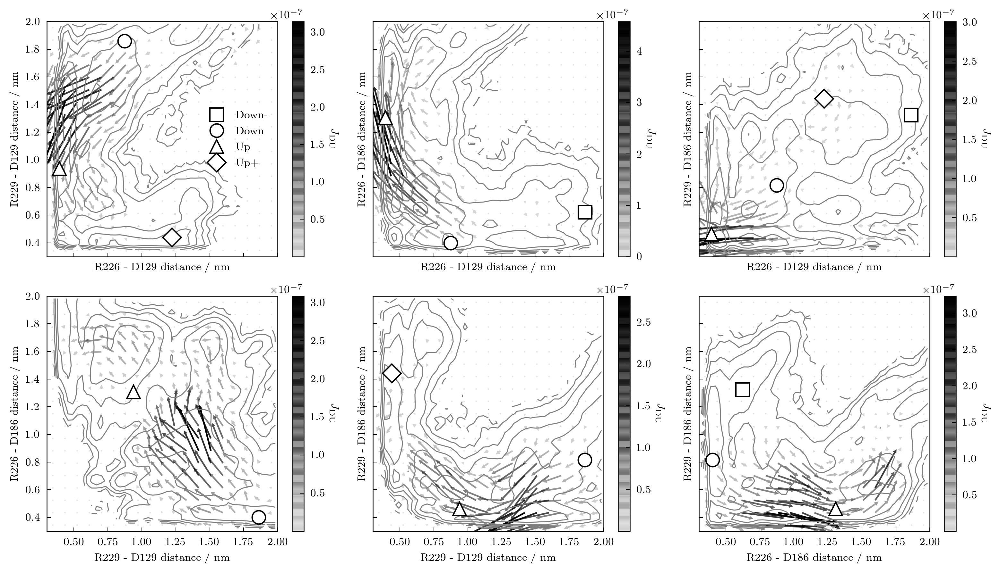

In [164]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)

flux = j_du_sb[-1]
for ((i, j), ax, p) in zip(combinations(range(4), 2), axs.flat, pmf_sb):
    sb1, sb2 = sb_ids[i], sb_ids[j]

    # KDE bin fluxes
    jx_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, i]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )
    jy_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, j]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )

    # set color/magnitude of arrow equal to L2 norm od KDEd fluxes
    col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

    # normalize arrow so same
    h = ax.quiver(
        X,
        Y,
        jx_binned.T,
        jy_binned.T,
        col.T,
        width=0.007,
        cmap=cmapwhite,
        headwidth=2.5,
        headlength=2.5,
        headaxislength=2.5,
    )
    cb = plt.colorbar(h, ax=ax)
    cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

    # plot PMF
    min_energy = np.min(-np.log(p[np.nonzero(p)]))
    diff = -np.log(p.T) - min_energy
    ax.contour(centerx, centery, diff * 0.593, levels=clines, colors="grey")

    ax.set(
        xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
        ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
        xlim=[0.3, 2.0],
        ylim=[0.3, 2.0],
    )

plotting.plot_sb_models(axs.flat, mode="du", centroids=True)
axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.tight_layout()

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in log


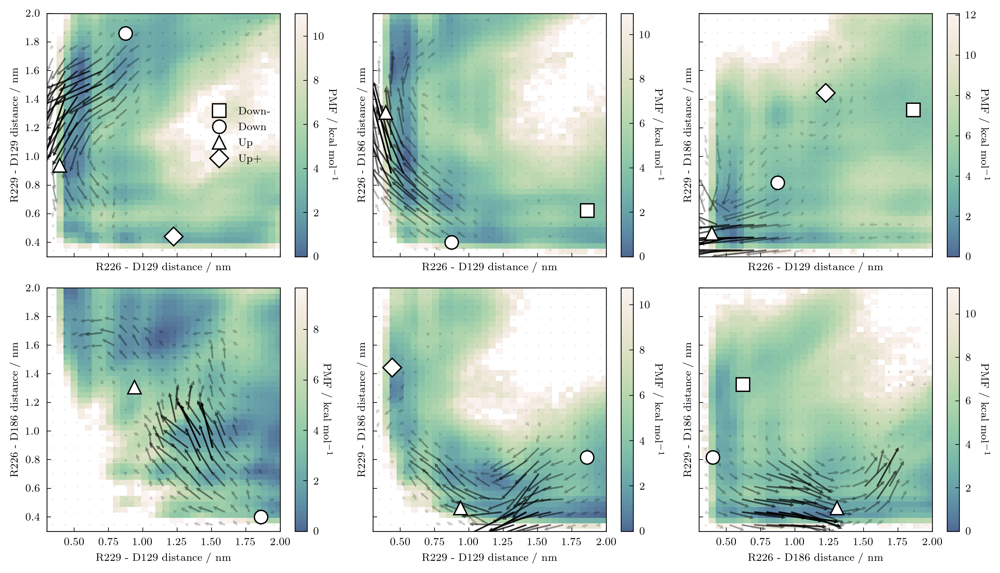

In [166]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)

flux = j_du_sb[-1]
for ((i, j), ax, p) in zip(combinations(range(4), 2), axs.flat, pmf_sb):
    sb1, sb2 = sb_ids[i], sb_ids[j]

    # KDE bin fluxes
    jx_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, i]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )
    jy_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, j]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )

    # set color/magnitude of arrow equal to L2 norm od KDEd fluxes
    col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

    # plot PMF
    min_energy = np.min(-np.log(p[np.nonzero(p)]))
    diff = -np.log(p.T) - min_energy
    h = ax.pcolor(xe, ye, diff, cmap=cm_seq)
    cb = plt.colorbar(h, ax=ax)
    cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

    ax.quiver(
        X,
        Y,
        jx_binned.T,
        jy_binned.T,
        col.T,
        width=0.007,
        cmap=cmapwhite,
        headwidth=2.5,
        headlength=2.5,
        headaxislength=2.5,
    )

    ax.set(
        xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
        ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
        xlim=[0.3, 2.0],
        ylim=[0.3, 2.0],
    )

plotting.plot_sb_models(axs.flat, mode="du", centroids=True)
axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.tight_layout()

In [59]:
sb_models = np.load("../../data/models_centroids_feat2.npy")

In [65]:
import importlib

importlib.reload(plotting)

<module 'plotting' from '/project2/roux/scguo/ci-vsd/jupyter/dga/../../python/plotting.py'>

/tmp/jobs/16494128/ipykernel_247788/3673228138.py:20: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(p.T) - min_energy


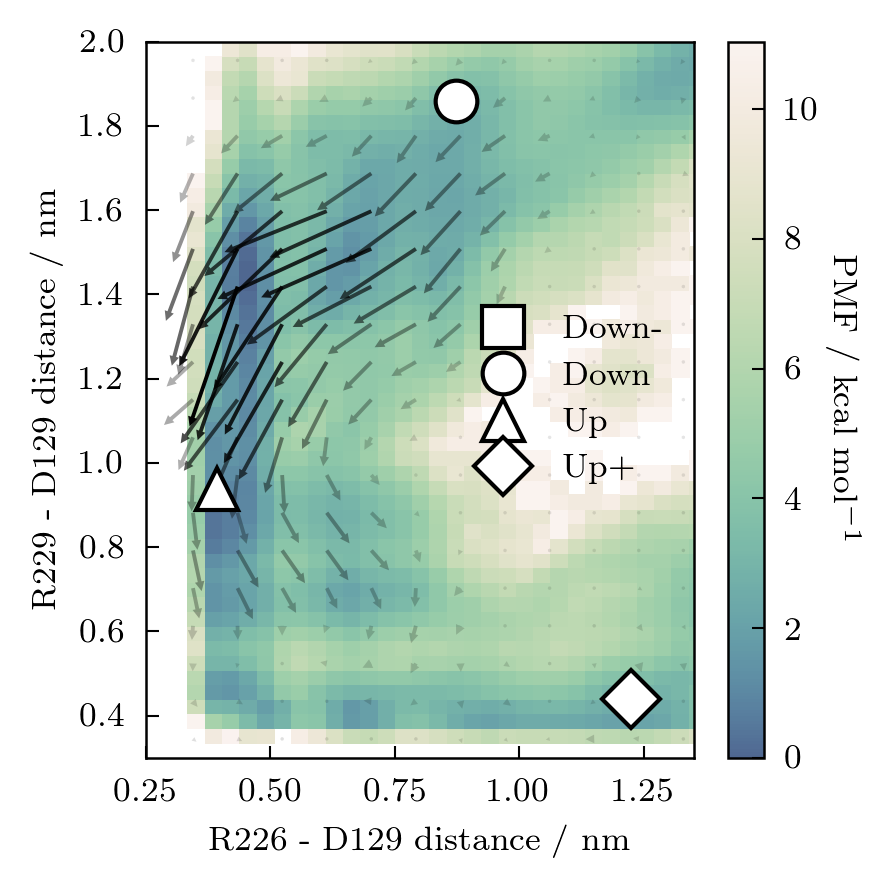

In [73]:
f, ax = plt.subplots(figsize=(3, 3), dpi=300)

flux = j_du_sb[-1]
sb1, sb2 = sb_ids[0], sb_ids[1]

# KDE bin fluxes
jx_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot PMF
p = pmf_sb[0]
min_energy = np.min(-np.log(p[np.nonzero(p)]))
diff = -np.log(p.T) - min_energy
h = ax.pcolor(xlim, ylim, diff, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
    ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
    xlim=[0.25, 1.35],
    ylim=[0.3, 2.0],
)

plotting.plot_models(ax, sb_models[:, [sb1, sb2]])
ax.legend(loc="right")
f.tight_layout()

/tmp/jobs/16494128/ipykernel_247788/2017752276.py:20: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(p.T) - min_energy


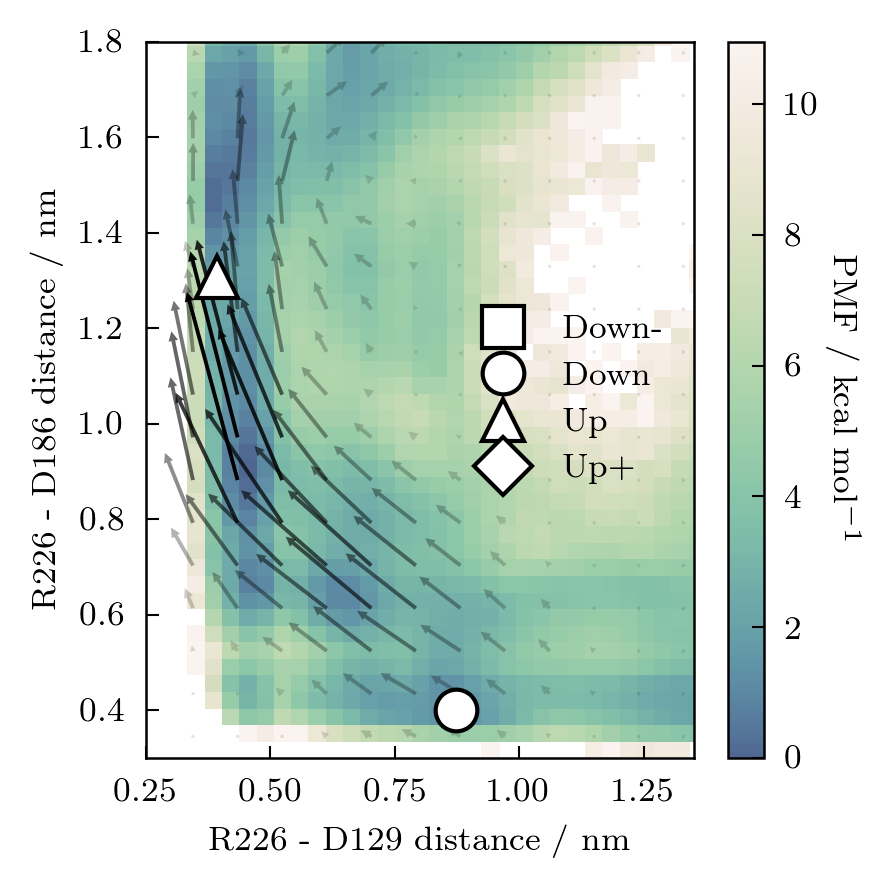

In [74]:
f, ax = plt.subplots(figsize=(3, 3), dpi=300)

flux = j_du_sb[-1]
sb1, sb2 = sb_ids[0], sb_ids[2]

# KDE bin fluxes
jx_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 0]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 2]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot PMF
p = pmf_sb[1]
min_energy = np.min(-np.log(p[np.nonzero(p)]))
diff = -np.log(p.T) - min_energy
h = ax.pcolor(xlim, ylim, diff, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
    ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
    xlim=[0.25, 1.35],
    ylim=[0.3, 1.8],
)

plotting.plot_models(ax, sb_models[:, [sb1, sb2]])
ax.legend(loc="right")
f.tight_layout()

/tmp/jobs/16494128/ipykernel_247788/4093204112.py:20: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(p.T) - min_energy


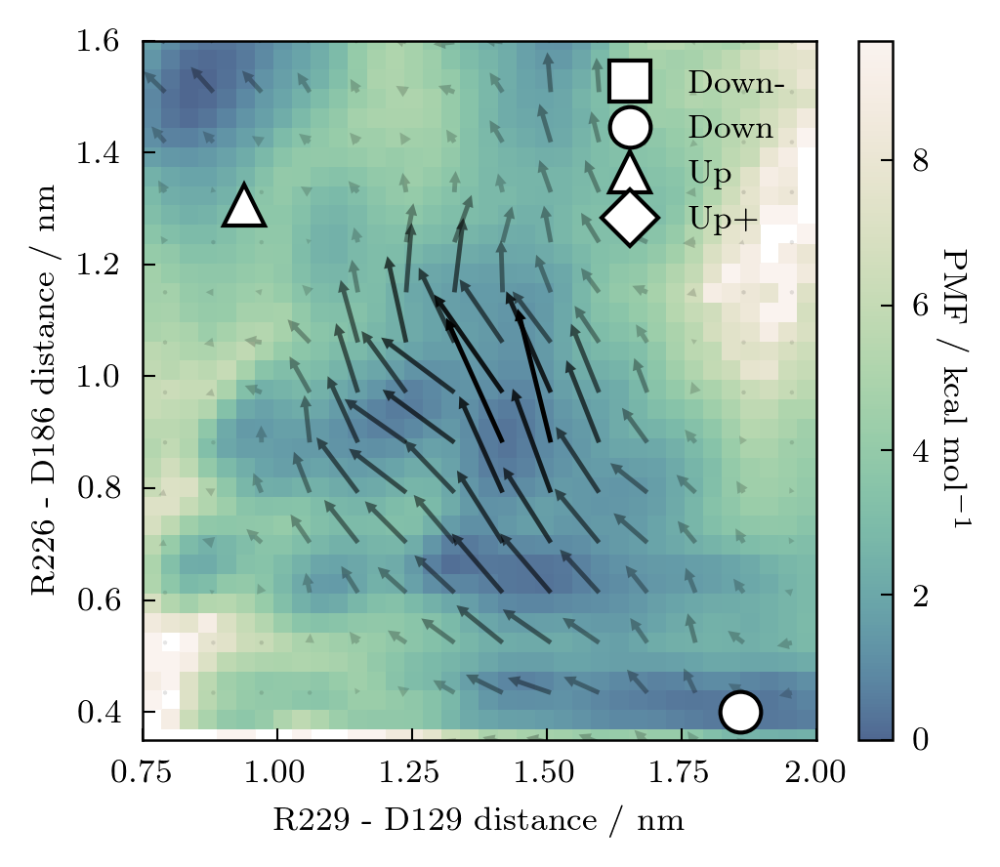

In [77]:
f, ax = plt.subplots(figsize=(3.5, 3), dpi=300)

flux = j_du_sb[-1]
sb1, sb2 = sb_ids[1], sb_ids[2]

# KDE bin fluxes
jx_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 2]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot PMF
p = pmf_sb[3]
min_energy = np.min(-np.log(p[np.nonzero(p)]))
diff = -np.log(p.T) - min_energy
h = ax.pcolor(xlim, ylim, diff, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
    ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
    xlim=[0.75, 2],
    ylim=[0.35, 1.6],
)

plotting.plot_models(ax, sb_models[:, [sb1, sb2]])
ax.legend(loc="upper right")
f.tight_layout()

/tmp/jobs/16494128/ipykernel_247788/900738414.py:20: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(p.T) - min_energy


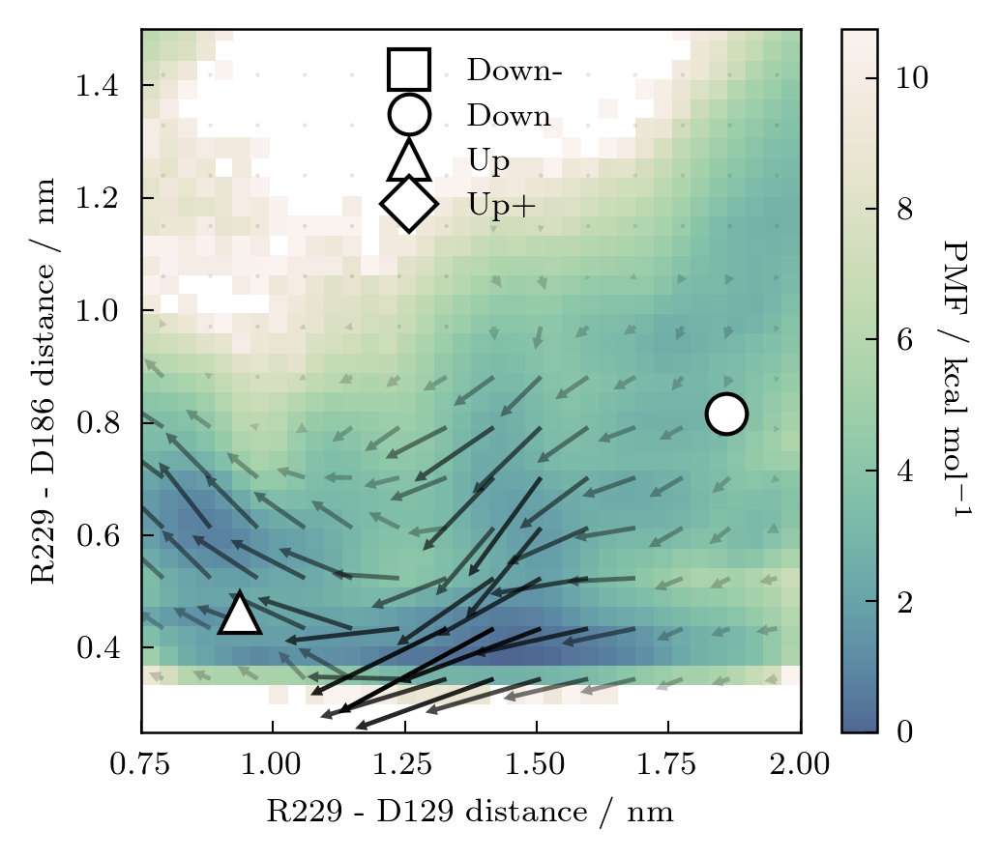

In [81]:
f, ax = plt.subplots(figsize=(3.5, 3), dpi=300)

flux = j_du_sb[-1]
sb1, sb2 = sb_ids[1], sb_ids[3]

# KDE bin fluxes
jx_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 1]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 3]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot PMF
p = pmf_sb[4]
min_energy = np.min(-np.log(p[np.nonzero(p)]))
diff = -np.log(p.T) - min_energy
h = ax.pcolor(xlim, ylim, diff, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
    ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
    xlim=[0.75, 2],
    ylim=[0.25, 1.5],
)

plotting.plot_models(ax, sb_models[:, [sb1, sb2]])
ax.legend(loc="upper center")
f.tight_layout()

/tmp/jobs/16494128/ipykernel_247788/3664469509.py:20: RuntimeWarning: divide by zero encountered in log
  diff = -np.log(p.T) - min_energy


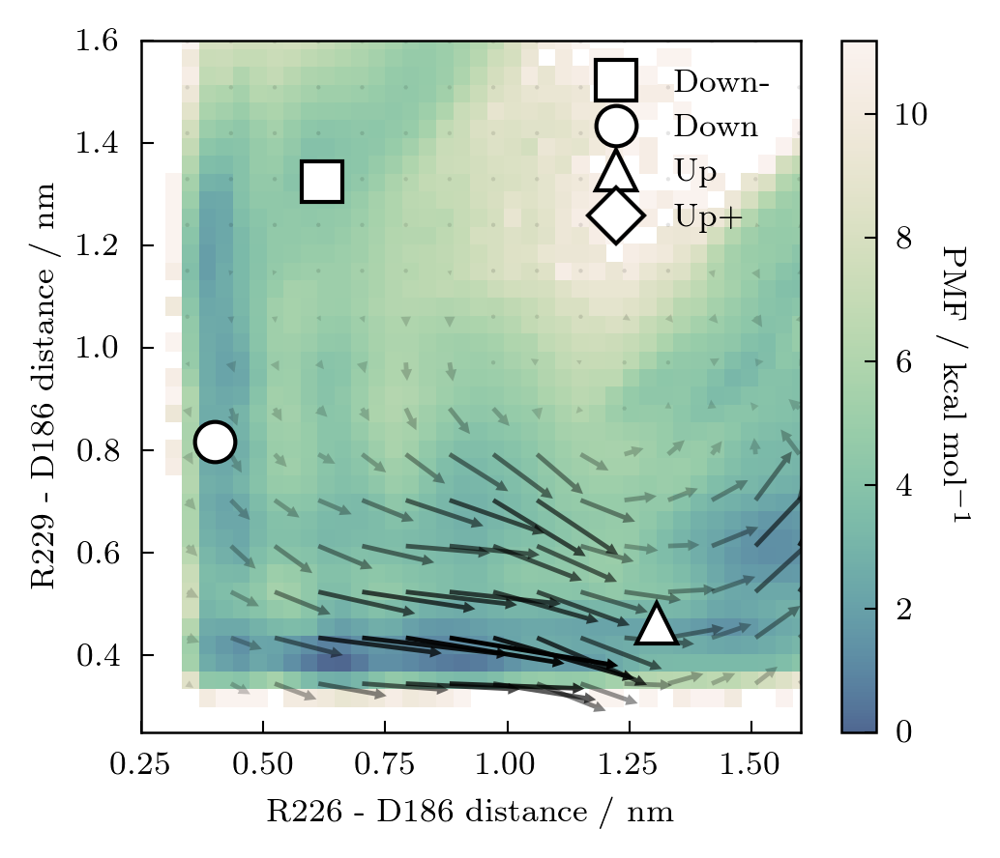

In [83]:
f, ax = plt.subplots(figsize=(3.5, 3), dpi=300)

flux = j_du_sb[-1]
sb1, sb2 = sb_ids[2], sb_ids[3]

# KDE bin fluxes
jx_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 2]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)
jy_binned, _, _ = util.kdesum2d(
    sb_arr[:, sb1],
    sb_arr[:, sb2],
    np.concatenate(flux[:, 3]),
    nx=n,
    ny=n,
    xmin=xmin,
    xmax=xmax,
    ymin=ymin,
    ymax=ymax,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

# plot PMF
p = pmf_sb[5]
min_energy = np.min(-np.log(p[np.nonzero(p)]))
diff = -np.log(p.T) - min_energy
h = ax.pcolor(xlim, ylim, diff, cmap=cm_seq)
cb = plt.colorbar(h, ax=ax)
cb.set_label("PMF / kcal mol$^{-1}$", rotation=-90, labelpad=10)

ax.quiver(
    X,
    Y,
    jx_binned.T,
    jy_binned.T,
    col.T,
    width=0.007,
    cmap=cmapwhite,
    headwidth=2.5,
    headlength=2.5,
    headaxislength=2.5,
)

ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
    ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
    xlim=[0.25, 1.6],
    ylim=[0.25, 1.6],
)

plotting.plot_models(ax, sb_models[:, [sb1, sb2]])
ax.legend(loc="upper right")
f.tight_layout()

NameError: name 'q_arr' is not defined

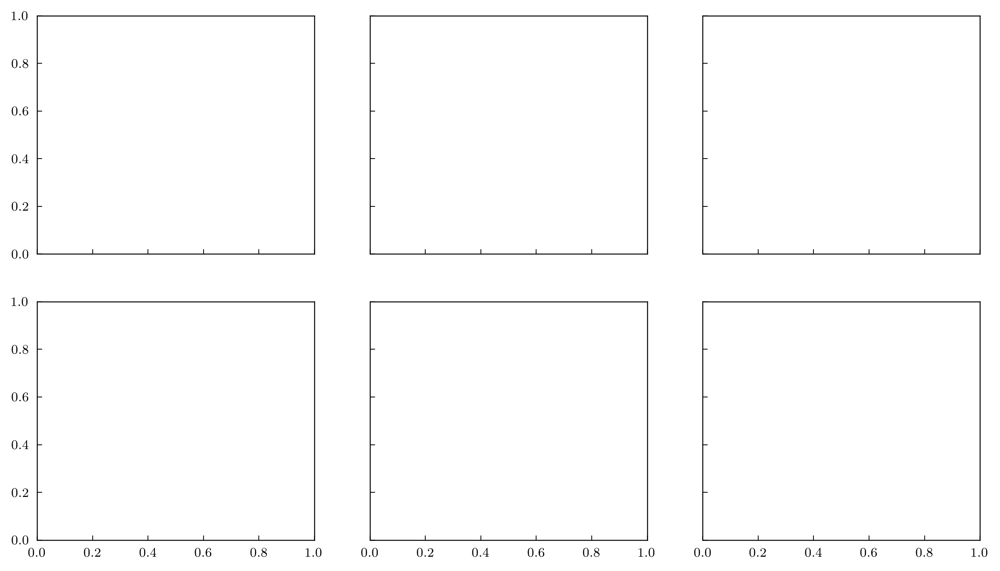

In [61]:
f, axs = plt.subplots(2, 3, figsize=(10.5, 6), sharex=True, sharey=True, dpi=300)

flux = j_du_sb[5]
for ((i, j), ax, p) in zip(combinations(range(4), 2), axs.flat, pmf_sb):
    sb1, sb2 = sb_ids[i], sb_ids[j]

    # KDE bin fluxes
    jx_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, i]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )
    jy_binned, _, _ = util.kdesum2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        np.concatenate(flux[:, j]),
        nx=n,
        ny=n,
        xmin=xmin,
        xmax=xmax,
        ymin=ymin,
        ymax=ymax,
    )

    # set color/magnitude of arrow equal to L2 norm od KDEd fluxes
    col = (jx_binned ** 2 + jy_binned ** 2) ** 0.5

    # compute reactive density
    q_dens, xe, ye = np.histogram2d(
        sb_arr[:, sb1], sb_arr[:, sb2], bins=n_pmf - 1, density=False, weights=q_arr * w
    )
    qb_dens, _, _ = np.histogram2d(
        sb_arr[:, sb1],
        sb_arr[:, sb2],
        bins=n_pmf - 1,
        density=False,
        weights=qb_arr * w,
    )
    w_dens, _, _ = np.histogram2d(
        sb_arr[:, sb1], sb_arr[:, sb2], bins=n_pmf - 1, density=False, weights=w
    )
    pi_reactive = diff * (q_dens / w_dens) * (qb_dens / w_dens)
    h = ax.pcolor(xe, ye, pi_reactive.T, cmap=cm_seq)
    cb = plt.colorbar(h, ax=ax)
    cb.set_label("$\pi q_+ q_-$", rotation=-90, labelpad=10)
    cb.set_ticks([])

    # Plot arrows
    ax.quiver(
        X,
        Y,
        jx_binned.T,
        jy_binned.T,
        col.T,
        width=0.007,
        cmap=cmapwhite,
        headwidth=2.5,
        headlength=2.5,
        headaxislength=2.5,
    )

    ax.set(
        xlabel=f"{sb_labels[sb1 - 30]} distance / nm",
        ylabel=f"{sb_labels[sb2 - 30]} distance / nm",
        xlim=[0.3, 2.0],
        ylim=[0.3, 2.0],
    )

plotting.plot_sb_models(axs.flat, mode="du", centroids=True)
axs.flat[0].legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.tight_layout()

## Committor direction

In [167]:
j_du_q, j_ud_q = [], []

for (lag, com, qp_f, qm_f, qp_b, qm_b) in zip(
    lags, weights, qp_du, qm_du, qp_ud, qm_ud
):
    print(f"Computing currents for lag = {lag}")
    j_du_q.append(extq.tpt.current(qp_f, qm_f, com, in_domain, qp, lag))
    j_ud_q.append(extq.tpt.current(qp_b, qm_b, com, in_domain, qp, lag))

Computing currents for lag = 1
Computing currents for lag = 2
Computing currents for lag = 5
Computing currents for lag = 10
Computing currents for lag = 20
Computing currents for lag = 50


In [274]:
# binning the Jx and Jy and Jz fluxes on the distance/spin/committor space
n = 19
xmin, xmax, ymin, ymax, zmin, zmax = -10, 10, -150, 100, 0, 1

In [275]:
xlim_flux = np.linspace(xmin, xmax, n + 1)
ylim_flux = np.linspace(ymin, ymax, n + 1)
zlim_flux = np.linspace(zmin, zmax, n + 1)

centerx_flux = (xlim_flux[1:] + xlim_flux[:-1]) / 2
centery_flux = (ylim_flux[1:] + ylim_flux[:-1]) / 2
centerz_flux = (zlim_flux[1:] + zlim_flux[:-1]) / 2

X, Y, Z = np.meshgrid(centerx_flux, centery_flux, centerz_flux)

In [182]:
from scipy.stats import kde

In [201]:
q_arr = np.concatenate(qp_du[0])
j_binned, _ = np.histogramdd(
    (cv_arr[:, 0], cv_arr[:, 1], q_arr),
    bins=n,
    range=((xmin, xmax), (ymin, ymax), (zmin, zmax)),
    weights=jx,
)

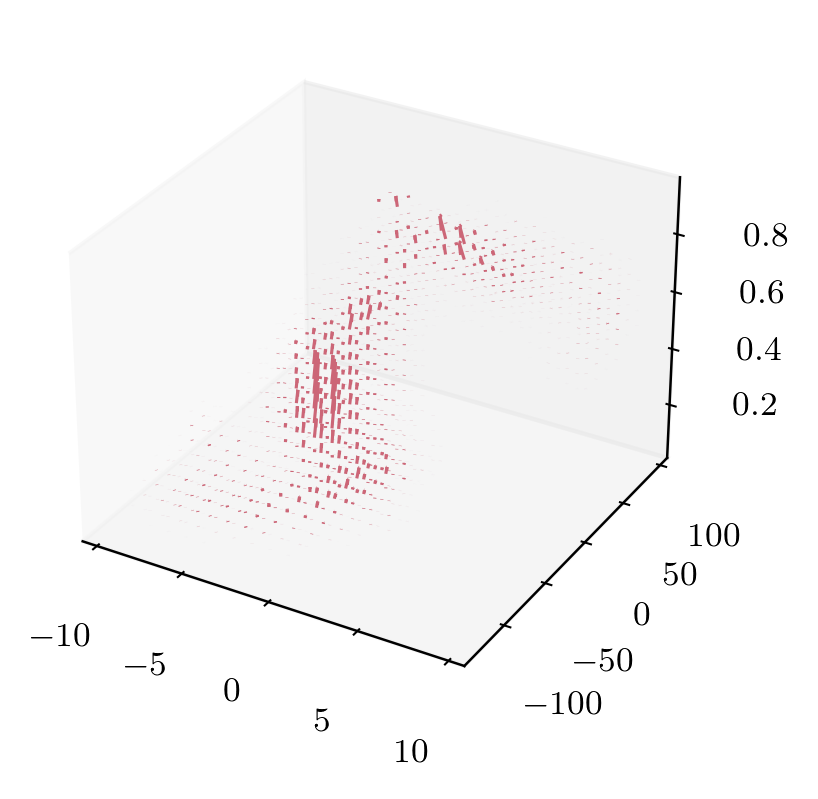

In [276]:
f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = f.add_subplot(projection="3d")

jx = np.concatenate(j_du_ds[0][:, 0])
jy = np.concatenate(j_du_ds[0][:, 1])
jz = np.concatenate(j_du_q[0])

q_arr = np.concatenate(qp_du[0])
bin_arr = np.stack((cv_arr[:, 0], cv_arr[:, 1], q_arr), axis=-1)
jx_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jx,
    density=True,
)
jy_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jy,
    density=True,
)
jz_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jz,
    density=True,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2 + jz_binned ** 2) ** 0.5
norm = mpl.colors.Normalize(vmin=np.min(col), vmax=np.max(col))
norm_col = norm(col.ravel())

# normalize arrow so same
h = ax.quiver(
    X,
    Y,
    Z,
    jx_binned.transpose((1, 0, 2)),
    jy_binned.transpose((1, 0, 2)),
    jz_binned.transpose((1, 0, 2)),
    cmap=cm_seq2,
    length=4,
    arrow_length_ratio=0.3,
)

# cb = plt.colorbar(h, ax=ax)
# cb.set_label("$J_{\mathrm{DU}}$", rotation=-90, labelpad=10)

In [262]:
feat2_models = np.load("../../data/models_centroids_feat2.npy")

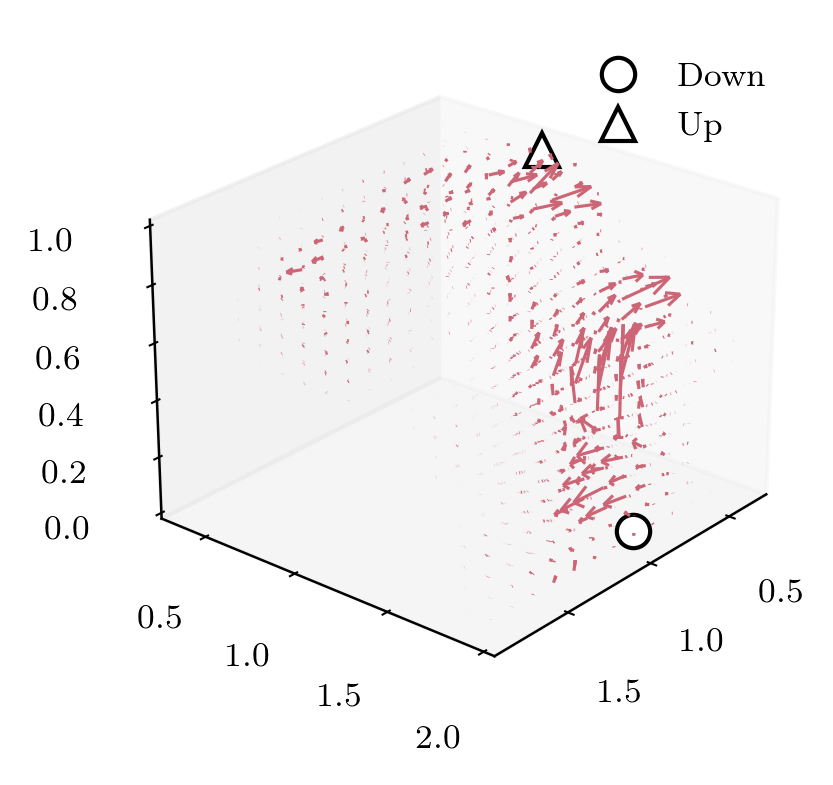

In [273]:
xmin, xmax, ymin, ymax, zmin, zmax = 0.3, 2.0, 0.3, 2.0, 0, 1
n = 14
xlim_flux = np.linspace(xmin, xmax, n + 1)
ylim_flux = np.linspace(ymin, ymax, n + 1)
zlim_flux = np.linspace(zmin, zmax, n + 1)

centerx_flux = (xlim_flux[1:] + xlim_flux[:-1]) / 2
centery_flux = (ylim_flux[1:] + ylim_flux[:-1]) / 2
centerz_flux = (zlim_flux[1:] + zlim_flux[:-1]) / 2

X, Y, Z = np.meshgrid(centerx_flux, centery_flux, centerz_flux)

f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = f.add_subplot(projection="3d")

jx = np.concatenate(j_du_sb[0][:, 0])
jy = np.concatenate(j_du_sb[0][:, 1])
jz = np.concatenate(j_du_q[0])

q_arr = np.concatenate(qp_du[0])
bin_arr = np.stack((sb_arr[:, sb_ids[0]], sb_arr[:, sb_ids[1]], q_arr), axis=-1)
jx_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jx,
    density=True,
)
jy_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jy,
    density=True,
)
jz_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jz,
    density=True,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2 + jz_binned ** 2) ** 0.5
norm = mpl.colors.Normalize(vmin=np.min(col), vmax=np.max(col))
norm_col = norm(col.ravel())

# normalize arrow so same
h = ax.quiver(
    X,
    Y,
    Z,
    jx_binned.transpose((1, 0, 2)),
    jy_binned.transpose((1, 0, 2)),
    jz_binned.transpose((1, 0, 2)),
    cmap=cm_seq2,
    length=0.01,
    arrow_length_ratio=0.4,
)

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.legend(["Down", "Up"], loc="upper right")

ax.view_init(azim=40, elev=25)

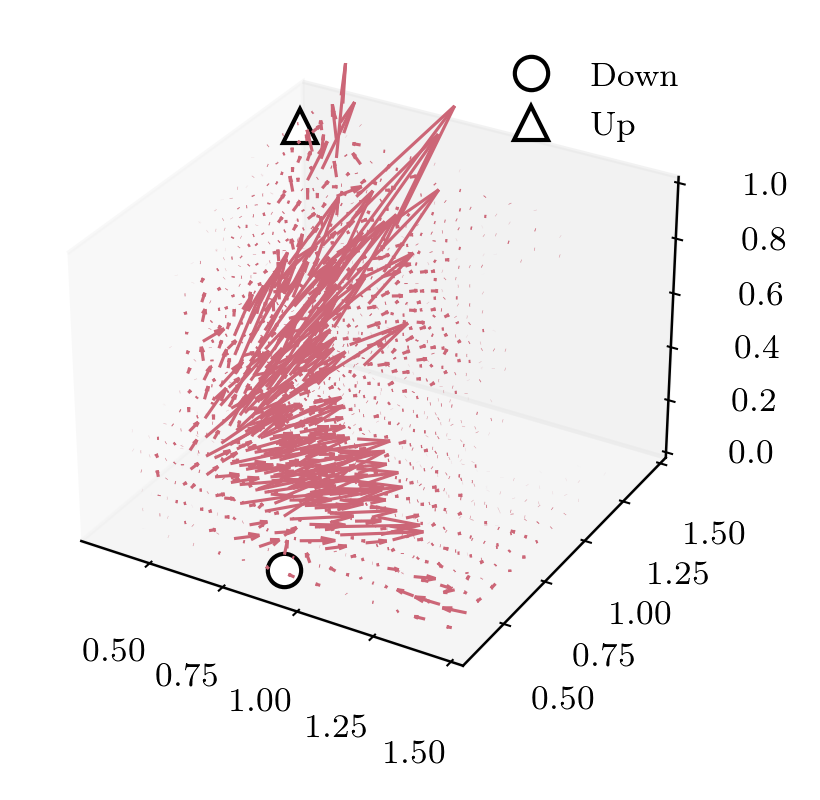

In [280]:
xmin, xmax, ymin, ymax, zmin, zmax = 0.3, 1.5, 0.3, 1.5, 0, 1
n = 14
xlim_flux = np.linspace(xmin, xmax, n + 1)
ylim_flux = np.linspace(ymin, ymax, n + 1)
zlim_flux = np.linspace(zmin, zmax, n + 1)

centerx_flux = (xlim_flux[1:] + xlim_flux[:-1]) / 2
centery_flux = (ylim_flux[1:] + ylim_flux[:-1]) / 2
centerz_flux = (zlim_flux[1:] + zlim_flux[:-1]) / 2

X, Y, Z = np.meshgrid(centerx_flux, centery_flux, centerz_flux)

f = plt.figure(figsize=(3.5, 3), dpi=300)
ax = f.add_subplot(projection="3d")

jx = np.concatenate(j_du_sb[0][:, 0])
jy = np.concatenate(j_du_sb[0][:, 2])
jz = np.concatenate(j_du_q[0])

q_arr = np.concatenate(qp_du[0])
bin_arr = np.stack((sb_arr[:, sb_ids[0]], sb_arr[:, sb_ids[2]], q_arr), axis=-1)
jx_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jx,
    density=True,
)
jy_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jy,
    density=True,
)
jz_binned, _ = np.histogramdd(
    bin_arr,
    bins=n,
    range=[(xmin, xmax), (ymin, ymax), (zmin, zmax)],
    weights=jz,
    density=True,
)

# set color/magnitude of arrow equal to L2 norm od KDEd fluxes
col = (jx_binned ** 2 + jy_binned ** 2 + jz_binned ** 2) ** 0.5
norm = mpl.colors.Normalize(vmin=np.min(col), vmax=np.max(col))
norm_col = norm(col.ravel())

# normalize arrow so same
h = ax.quiver(
    X,
    Y,
    Z,
    jx_binned.transpose((1, 0, 2)),
    jy_binned.transpose((1, 0, 2)),
    jz_binned.transpose((1, 0, 2)),
    cmap=cm_seq2,
    length=0.01,
    arrow_length_ratio=0.4,
)

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[2]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[2]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.legend(["Down", "Up"], loc="upper right")

# ax.view_init(azim=40, elev=25)